- The ground state is calculated by the classical exact solver statevector_simulator.

- The pauli strings are calculated by the "estimator" with the backend "ibm_oslo".

- The code is restructured so that the dynamics can be iterated in one single session, which could reduce the time waiting in the queues and transforming data between our devices and the IBM server. 

- When the session starts, the program will wait in the queue for some time (depends on how long the queue is). After that, the following iterations are priorized so that each iteration only waits for around 1s and costs 20-30 s in total.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from pyscf import ao2mo,gto, scf

from typing import Tuple


# qiskit
from qiskit.algorithms import VQE
from qiskit.algorithms.optimizers import COBYLA, SPSA, SLSQP, NELDER_MEAD
from qiskit.algorithms import MinimumEigensolverResult

from qiskit import IBMQ, BasicAer, Aer
from qiskit.utils import QuantumInstance
from qiskit.quantum_info.operators import Operator
from qiskit.opflow import PauliExpectation, CircuitSampler, StateFn, CircuitStateFn
from qiskit.opflow.primitive_ops import PauliOp, PauliSumOp
from qiskit.quantum_info import Pauli, SparsePauliOp

# qiskit nature
from qiskit_nature.second_q.hamiltonians import ElectronicEnergy
from qiskit_nature.second_q.mappers import ParityMapper, QubitConverter
from qiskit_nature.second_q.problems import ElectronicStructureProblem
from qiskit_nature.second_q.operators import FermionicOp
from qiskit_nature.second_q.properties import ParticleNumber
from qiskit_nature.second_q.transformers import FreezeCoreTransformer
from qiskit_nature.second_q.circuit.library import UCCSD, HartreeFock
from qiskit_nature.second_q.problems import ElectronicBasis
from qiskit_nature.second_q.formats.molecule_info import MoleculeInfo

from qiskit_nature.settings import settings
settings.dict_aux_operators = True

from qiskit import IBMQ
from qiskit_nature.runtime import VQEClient
from qiskit.providers.ibmq import least_busy
from qiskit_ibm_runtime import QiskitRuntimeService, Estimator, Session

# useful??
#from qiskit_nature.algorithms import (GroundStateEigensolver,
#                                      NumPyMinimumEigensolverFactory)
from qiskit.circuit.library import EfficientSU2
from qiskit.circuit.library import RealAmplitudes
from qiskit.utils.mitigation import CompleteMeasFitter
from qiskit.providers.aer.noise import NoiseModel
from qiskit.providers.aer import QasmSimulator
from qiskit import QuantumCircuit, transpile
from qiskit.opflow import TwoQubitReduction

In [15]:
IBMQ.load_account()
service = QiskitRuntimeService() #load account
provider = IBMQ.get_provider()
# backend = provider.get_backend('ibmq_qasm_simulator')
backend = provider.get_backend('ibmq_quito')
can_use_runtime = provider.has_service('runtime')
can_use_runtime

ibmqfactory.load_account:WARNING:2022-11-19 22:39:49,344: Credentials are already in use. The existing account in the session will be replaced.


True

In [14]:
qdev = provider.backends(simulator=False, operational=True)
least_busy(qdev)

<IBMQBackend('ibmq_quito') from IBMQ(hub='ibm-q', group='open', project='main')>

In [3]:
def get_molecular_integrals(molecule):
    '''
    Calculates the 1-electron and 2-electron integrals.
    
    Args:   
        molecule : Mole 
            Ccorresponds to the molecule.
            
    Returns:
        h1_MO : ndarray
                Tensor corresponding to the 1-electron integral in the molecular basis.
        
        h2_MO : ndarray
                Tensor corresponding to the 2-electron integral in the molecular basis.

        n_particles: Tuple[int, int]
            Number of alpha and beta electrons.
        
        num_orb : int 
            Number of orbitals.

        nuclear_repulsion_energy : float
            Nuclear repulsion energy.
    '''
    
    mf = scf.RHF(molecule).run()

    # computing the 1e and 2e AO (atomic orbitals) integrals 
    h1 = molecule.intor_symmetric("int1e_nuc") + molecule.intor_symmetric("int1e_kin") 
    h2 = molecule.intor("int2e")
    # comment : add aosym (axis of symmetry) ???

    # transformations from AO to MO (molecular orbitals)
    h1_MO = np.einsum('pi,pq,qj->ij', mf.mo_coeff, h1, mf.mo_coeff)
    h2_MO = ao2mo.get_mo_eri(h2, mf.mo_coeff)

    #h2_MO = ao2mo.kernel(mol_h2, mf.mo_coeff, aosym="1") #alternative

    nuclear_repulsion_energy=molecule.energy_nuc()
    num_particles = molecule.nelec
    num_orb = h1.shape[0]

    return h1_MO, h2_MO, num_particles, num_orb, nuclear_repulsion_energy


def get_qubit_op(coordinates):
    '''
    Calculates the Hamiltonian as the sum of Pauli operators as a function
    of the coordinates of the atoms.
    
    Args:
        coordinates : ndarray
            Array containing the positions of the atoms constituing the molecule.
        
    
    Returns:
        qubit_op : PauliSumOp
            Sum of Pauli operators corresponding to the Hamiltonian.
        
        nelec : Tuple[int, int]
            Number of alpha and beta electrons.
        
        norb : int 
            Number of orbitals.
            
        problem : ElectronicStructureProblem
        
        converter : QubitConverter
    '''
    
    mol = gto.M(
                atom = [['H',(coordinates[0], 0.0, 0.0)], 
                        ['H',(coordinates[1], 0.0, 0.0)]],
                basis = 'sto3g',
                charge = 0,
                spin = 0,
                symmetry = True,
                verbose = 2 # control the print level of PySCF globally
    )

    h1_MO,h2_MO,nelec,norb,ecore = get_molecular_integrals(mol)

    # Define an ElectronicEnergy instance containing the 1e and 2e integrals
    electronic_energy = ElectronicEnergy.from_raw_integrals(
            h1_MO, ao2mo.restore(1, h2_MO, norb)
        )
    electronic_energy.nuclear_repulsion_energy = ecore

    # Define an ElectronicStructureProblem
    problem = ElectronicStructureProblem(electronic_energy)

    second_q_ops = problem.second_q_ops()     # get second quantized operators
    problem.num_spatial_orbitals = norb  # define number of orbitals
    problem.num_particles = nelec        # define number of particles 
    
    problem.basis = ElectronicBasis.MO 
    
    problem.molecule=MoleculeInfo(symbols=[mol.atom_symbol(i) for i in range(mol.nbas)], 
                                  coords=mol.atom_coords())
    FC_transformer=FreezeCoreTransformer(freeze_core=True)
    problem = FC_transformer.transform(problem)
    
    # TODO we need to give info about the molecule to use FreezeCoreTransformer 
    # question : how to do it in a smart way ? at the initialization ??
    
    hamiltonian = second_q_ops[0]  # Set electronic part of Hamiltonian
    hamiltonian = (hamiltonian + FermionicOp({"": ecore}, num_spin_orbitals=norb)) # add Nuclear Repulsion Energy
    #print("Hamiltonian :\n", hamiltonian) # print for checking purposes
    
    mapper = ParityMapper()  # Set Mapper
    
    # Do two qubit reduction
    converter = QubitConverter(mapper,two_qubit_reduction=True)
    qubit_op = converter.convert(hamiltonian, nelec)
    #print("q_op :\n", qubit_op) # print for checking purposes
    

    return qubit_op, nelec, norb, problem, converter

In [5]:
# #Canonical
# from tqdm import tqdm #to show progress

# Ha = 4.36e-18
# angst = 1.0e-10
# dR = 0.02 # in Angstrom

# femto = 1.0e-15
# angst = 1.0e-10
# u = 1.67e-27
# #mass of particle1 (H)
# mass_0 = u
# #mass of particle2 (H)
# mass_1 = u
# mass = [mass_0, mass_1]
# #time step of integrator
# dt = 0.2*femto
# #initial velocity of atoms
# v_init = [0, 0]
# # v_init = [(np.array(momentum[-1])/mass*u*angst/femto)[0], (np.array(momentum[-1])/mass*u*angst/femto)[1]]
# #initial positions of atoms
# init_pos = [0, 0.6]
# # init_pos = coords[-1]
# shots = 1024

# #integrator timesteps
# times = np.arange(0*femto, 40.0*femto, dt)

# #k_B*T in Joule
# k_B = 1.38065e-23
# T = 420
# k_T = k_B*T
# #delta factor
# delta = 8*dt

# coords = [init_pos]
# # coords = coords
# momentum = [[mass[0]/u*v_init[0]/angst*femto, mass[1]/u*v_init[1]/angst*femto]]
# # momentum = momentum
# # force = []
# pauli_op_array = np.array([])

In [4]:
intermediate_info = {"nfev": [], "parameters": [], "energy": [], "stddev": []}

def raw_callback(*args):
    # check if interim results, since both interim results (list) and final results (dict) are returned
    if type(args[1]) is list:
        job_id, (nfev, parameters, energy, stddev) = args
        intermediate_info["nfev"].append(nfev)
        intermediate_info["parameters"].append(parameters)
        intermediate_info["energy"].append(energy)
        intermediate_info["stddev"].append(stddev)

# test_op = SparsePauliOp.from_list([("II", 1)])
# test_circ = RealAmplitudes(num_qubits=2, reps=2)

In [5]:
def calc_ground_state(qubit_op,nelec,norb,problem,converter) :
    '''
    Calculates the ground state and the ground energy of the Hamiltonian.
    
    Args:
        qubit_op : PauliSumOp
            Sum of Pauli operators corresponding to the Hamiltonian.
        
        nelec : Tuple[int, int]
            Number of alpha and beta electrons.
        
        norb : int 
            Number of orbitals.
            
        problem : ElectronicStructureProblem
        
        converter : QubitConverter
        
    
    Returns:
        ground_state : CircuitStateFn
            Ground state of the Hamiltonian.
            
        min_eng : float
            Ground energy of the Hamiltonian.
    '''

    backend = BasicAer.get_backend("statevector_simulator")
    quantum_instance = QuantumInstance(backend)
    optimizer = SLSQP(maxiter=5)

    init_state = HartreeFock(num_spatial_orbitals=norb, 
                                num_particles=nelec, 
                                qubit_converter=converter
                            )
    
    var_form = UCCSD(qubit_converter=converter,
                        num_particles=nelec,
                        num_spatial_orbitals=norb, 
                        initial_state=init_state
                        )

    vqe = VQE(var_form, optimizer, quantum_instance=quantum_instance) 
    vqe_result = vqe.compute_minimum_eigenvalue(qubit_op)
    min_eng = vqe_result.eigenvalue.real
    final_params = vqe_result.optimal_parameters 

    vqe_ground = vqe.ansatz.bind_parameters(final_params) 
#     vqe_ground_state = CircuitStateFn(vqe_ground)
    
    return vqe_ground, min_eng

In [6]:
#Canonical
from tqdm import tqdm #to show progress

Ha = 4.36e-18
angst = 1.0e-10
dR = 0.02 # in Angstrom

femto = 1.0e-15
angst = 1.0e-10
u = 1.67e-27
#mass of particle1 (H)
mass_0 = u
#mass of particle2 (H)
mass_1 = u
mass = [mass_0, mass_1]
#time step of integrator
dt = 0.2*femto
#initial velocity of atoms
v_init = [0, 0]
# v_init = [(np.array(momentum[-1])/mass*u*angst/femto)[0], (np.array(momentum[-1])/mass*u*angst/femto)[1]]
#initial positions of atoms
init_pos = [0, 0.6]
# init_pos = coords[-1]
shots = 1024

#integrator timesteps
times = np.arange(0*femto, 100.0*femto, dt)

#k_B*T in Joule
k_B = 1.38065e-23
T = 420
k_T = k_B*T
#delta factor
delta = 8*dt

coords = [init_pos]
# coords = coords
momentum = [[mass[0]/u*v_init[0]/angst*femto, mass[1]/u*v_init[1]/angst*femto]]
# momentum = momentum
# force = []
pauli_op_array = np.array([])


# with Session(service=service, backend="ibmq_qasm_simulator") as session:
with Session(service=service, backend="ibm_oslo") as session:
    estimator = Estimator(session=session)
    estimator.set_options(shots=shots)
    
#     test_job = estimator.run(circuits=test_circ, observables=test_op, parameter_values=[1,1,1,1,1,1])
#     session_id = session.session_id
    
    for time in tqdm(times, desc='Progress: '):
        coordinates = coords[-1]
        num_coord = len(coordinates)    
        forces = np.zeros(num_coord)
        force_ops = []
        force_op_coeffs = [] # array with dictionaries containing Pauli coefficients
        
        for i in range(num_coord):

            #get qubit operators coresponding to H+ (hamiltonian for atomic distances R + dR)
            (qubit_op_plus, num_part_plus, num_orb_plus, problem_plus, converter_plus) = get_qubit_op(coordinates[0:i]+[(coordinates[i]+dR)]+coordinates[i+1:])

            #get qubit operators coresponding to H- (hamiltonian for atomic distances R - dR)
            (qubit_op_minus, num_part_minus, num_orb_minus, problem_minus, converter_minus) = get_qubit_op(coordinates[0:i]+[(coordinates[i]-dR)]+coordinates[i+1:])


            op = (qubit_op_minus - qubit_op_plus).reduce()                  
            op_list = op.primitive.to_list() #list containing Pauli operators in support and corresponding coeffs

            force_ops.append(op)
            force_op_coeffs.append(op_list)

            if i == 0:  #we need two Pauli Ops to calculate the product and their support
                P1 = op

        if pauli_op_array.size == 0:

            pauli_op_set = {'II'} #Could not initialize empty set for some reason
            # construct set of PauliOp products that we need to calculate

            for (PauliString,coeff) in force_op_coeffs[0]:
                pauli_op_set.add(PauliString)

            #to get set of necessary PauliOp products:
                P_prod = (P1@P1).reduce()
                P_list = P_prod.primitive.to_list()

                for (PauliString,coeff) in P_list:
                    pauli_op_set.add(PauliString)

            pauli_op_array = np.array(list(pauli_op_set))

        # transform pauli strings into the form of PauliSumOp to measure them in the estimator session
        paulis_ops = []
        for PauliString in pauli_op_array:
            paulis_ops.append(PauliSumOp(SparsePauliOp(PauliString)))

        # Now we calculate the expectation values of all the relevant PauliOps   
        exp_dict = {} # dictionary with relevant expectation values

        # Calculate ground state with runtime vqe
        ops, num_part, num_orb, es_problem, converter = get_qubit_op(coordinates)
        
        psi_0,_=calc_ground_state(ops, num_part, num_orb, es_problem, converter)

#         init_state = HartreeFock(num_spatial_orbitals=num_orb, 
#                             num_particles=num_part, 
#                             qubit_converter=converter
#                             )
    
#         ansatz = UCCSD(qubit_converter=converter,
#                             num_particles=num_part,
#                             num_spatial_orbitals=num_orb, 
#                             initial_state=init_state
#                             )

#         initial_point = np.random.uniform(-np.pi, np.pi, len(ansatz.parameters))
#         optimizer = SPSA(maxiter=100)
#         backend_options = {"backend_name": backend}
        
#         vqe_inputs = {
#             "ansatz": ansatz,
#             "operator": ops,
#             "optimizer": optimizer, 
#             "initial_point": initial_point,
#             "measurement_error_mitigation": True,
#             "shots": shots,
#         }

#         if time == 0:
#             job = service.run(program_id="vqe", inputs=vqe_inputs, options=backend_options, callback=raw_callback, start_session=True)
#             session_id = job.job_id
#         else:
#             job = service.run(program_id="vqe", inputs=vqe_inputs, options=backend_options, callback=raw_callback, session_id=session_id)

        
#         runtime_result = job.result()
#         psi_0 = ansatz.bind_parameters(runtime_result["optimal_point"])
        
#         runtime_vqe = VQEClient(ansatz=ansatz,
#                          optimizer=optimizer,
#                          initial_point=initial_point,
#                          provider=provider,
#                          backend=backend,
#                          shots=shots,
#                          measurement_error_mitigation=True)

#         runtime_result = runtime_vqe.compute_minimum_eigenvalue(ops)
#         vqe_sol = runtime_result.optimal_value + es_problem.grouped_property_transformed.get_property("ElectronicEnergy").nuclear_repulsion_energy
#         psi_0 = ansatz.bind_parameters(runtime_result.optimal_point)
#         convergence = runtime_result.optimizer_history['energy']


        # Calculate the expectations of the Pauli strings with estimator

        paulis_exp = estimator.run(circuits=[psi_0]*len(pauli_op_array), observables=paulis_ops)

        exp_dict = {} # dictionary with relevant expectation values

        for i in range(len(pauli_op_array)):

            pauli_string = pauli_op_array[i]
            E = paulis_exp.result().values.real[i]
            exp_dict[pauli_string] = E

        for i in range(len(coordinates)):
            for (pauli_op,coeff) in force_op_coeffs[i]:
                    forces[i] += coeff.real*exp_dict[pauli_op]

        COV = np.zeros((num_coord,num_coord)) #force covariance matrix, without some multiplicative factors. 
        COV_diag = np.zeros((num_coord,num_coord)) #only diagonal terms. 

        for i in range(num_coord):
            for j in range(i,num_coord):
                Pij = (force_ops[i]@force_ops[j]).reduce()
                Pij_list = Pij.primitive.to_list()

                #add product expectation 
                for (pauli_string,coeff) in Pij_list:
                    COV[i,j] += coeff.real*exp_dict[pauli_string]
                #subtract 
                COV[i,j] -= forces[i]*forces[j]

                #since COV is symmetric
                if i < j:
                    COV[j,i] = COV[i,j] 
            COV_diag[i,i] = COV[i,i]

        forces = forces*Ha*(1/(2*dR*angst))
        COV = COV*(Ha*(1/(2*dR*angst)))**2

        f0 = forces[0]
        f1 = forces[1]
                
        if time == 0:
            #get force component operators and decomposition (without the 1/(2*dR) factor, for numerical reasons) 
            v_next = v_init - delta/(2*k_T*np.sqrt(mass_0*mass_1))*np.matmul(COV,v_init)/shots*dt + np.concatenate((f0/mass_0,f1/mass_1),axis=None)*dt      
            r_next = (np.array(coordinates)*angst + dt*v_next)/angst

        else:        
            v_next += - delta/(2*k_T*np.sqrt(mass_0*mass_1))*np.matmul(COV,v_next)/shots*dt + np.concatenate((f0/mass_0,f1/mass_1),axis=None)*dt
            r_next = (np.array(coordinates)*angst + dt*v_next)/angst

        coords.append([r_next[0], r_next[1]])
        momentum.append([mass[0]/u*v_next[0]/angst*femto, mass[1]/u*v_next[1]/angst*femto])
        print(coords)
        print(momentum)

Progress:   0%|▏                                                              | 1/500 [4:52:50<2435:31:54, 17570.97s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697]]


Progress:   0%|▎                                                               | 2/500 [4:53:12<1002:36:32, 7247.78s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335]]


Progress:   1%|▍                                                                | 3/500 [4:53:34<545:05:06, 3948.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728]]


Progress:   1%|▌                                                                | 4/500 [4:53:53<330:15:56, 2397.09s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779]]


Progress:   1%|▋                                                                | 5/500 [4:54:13<211:44:18, 1539.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842]]


Progress:   1%|▊                                                                | 6/500 [4:54:32<140:21:09, 1022.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497]]


Progress:   1%|▉                                                                  | 7/500 [4:54:51<95:06:57, 694.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603]]


Progress:   2%|█                                                                  | 8/500 [4:56:17<68:26:22, 500.78s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835]]


Progress:   2%|█▏                                                                 | 9/500 [4:58:40<53:04:18, 389.12s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835], [-0.09078636461773283, 0.09078636461773505]]


Progress:   2%|█▎                                                                | 10/500 [5:00:30<41:12:09, 302.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835], [-0.09078636461773283, 0.09078636461773505], [-0.0847530547164718, 0.08475305471647324]]


Progress:   2%|█▍                                                                | 11/500 [5:00:53<29:29:47, 217.15s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835], [-0.09078636461773283, 0.09078636461773505], [-0.0847530547164718, 0.08475305471647324], [-0.07799274725835749, 0.07799274725835882]

Progress:   2%|█▌                                                                | 12/500 [5:01:12<21:15:41, 156.85s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835], [-0.09078636461773283, 0.09078636461773505], [-0.0847530547164718, 0.08475305471647324],

Progress:   3%|█▋                                                                | 13/500 [5:02:11<17:13:18, 127.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835], [-0.09078636461773283, 0.09078636461773505],

Progress:   3%|█▉                                                                 | 14/500 [5:02:30<12:45:46, 94.54s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-0.09509033961694609, 0.09509033961694835], 

Progress:   3%|██                                                                  | 15/500 [5:02:49<9:41:15, 71.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0.0963785416725926, 0.09637854167259603], [-

Progress:   3%|██▏                                                                 | 16/500 [5:03:08<7:31:46, 56.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0.0945627612065407, 0.09456276120654497], [-0

Progress:   3%|██▎                                                                 | 17/500 [5:03:27<6:01:32, 44.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.08959389381807732, 0.08959389381807842], [-0

Progress:   4%|██▍                                                                 | 18/500 [5:03:47<5:00:44, 37.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.08023854373019837, 0.08023854373019779], [-0.

Progress:   4%|██▌                                                                 | 19/500 [5:04:06<4:15:06, 31.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06704555557825709, 0.06704555557825728], [-0.0

Progress:   4%|██▋                                                                 | 20/500 [5:04:24<3:42:01, 27.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.04806892602252219, 0.04806892602252335], [-0.06

Progress:   4%|██▊                                                                 | 21/500 [5:04:43<3:19:34, 25.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208]]
[[0.0, 0.0], [-0.02582978245868697, 0.02582978245868697], [-0.048

Progress:   4%|██▉                                                                 | 22/500 [5:05:02<3:04:59, 23.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154]]
[[0.0, 0.0], [-0.02582

Progress:   5%|███▏                                                                | 23/500 [5:05:20<2:52:18, 21.67s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   5%|███▎                                                                | 24/500 [5:05:39<2:44:42, 20.76s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   5%|███▍                                                                | 25/500 [5:05:58<2:41:41, 20.42s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   5%|███▌                                                                | 26/500 [5:06:18<2:38:15, 20.03s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   5%|███▋                                                                | 27/500 [5:06:37<2:35:58, 19.79s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   6%|███▊                                                                | 28/500 [5:06:56<2:34:02, 19.58s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   6%|███▉                                                                | 29/500 [5:07:16<2:35:01, 19.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   6%|████                                                                | 30/500 [5:07:36<2:36:11, 19.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   6%|████▏                                                               | 31/500 [5:07:55<2:33:25, 19.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   6%|████▎                                                               | 32/500 [5:08:15<2:33:45, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   7%|████▍                                                               | 33/500 [5:08:35<2:32:29, 19.59s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   7%|████▌                                                               | 34/500 [5:08:53<2:29:55, 19.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   7%|████▊                                                               | 35/500 [5:09:12<2:28:14, 19.13s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   7%|████▉                                                               | 36/500 [5:09:32<2:30:03, 19.40s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   7%|█████                                                               | 37/500 [5:09:51<2:29:00, 19.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   8%|█████▏                                                              | 38/500 [5:10:10<2:28:01, 19.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   8%|█████▎                                                              | 39/500 [5:10:30<2:28:47, 19.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   8%|█████▍                                                              | 40/500 [5:10:48<2:26:41, 19.13s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   8%|█████▌                                                              | 41/500 [5:11:07<2:26:08, 19.10s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   8%|█████▋                                                              | 42/500 [5:11:27<2:25:54, 19.12s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   9%|█████▊                                                              | 43/500 [5:11:47<2:28:14, 19.46s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   9%|█████▉                                                              | 44/500 [5:12:07<2:28:56, 19.60s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   9%|██████                                                              | 45/500 [5:12:26<2:27:38, 19.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   9%|██████▎                                                             | 46/500 [5:12:45<2:26:50, 19.41s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:   9%|██████▍                                                             | 47/500 [5:13:04<2:26:08, 19.36s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  10%|██████▌                                                             | 48/500 [5:13:22<2:22:52, 18.97s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  10%|██████▋                                                             | 49/500 [5:13:42<2:24:16, 19.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  10%|██████▊                                                             | 50/500 [5:14:01<2:22:05, 18.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  10%|██████▉                                                             | 51/500 [5:14:21<2:24:26, 19.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  10%|███████                                                             | 52/500 [5:14:41<2:26:00, 19.55s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  11%|███████▏                                                            | 53/500 [5:15:00<2:24:28, 19.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  11%|███████▎                                                            | 54/500 [5:15:19<2:23:00, 19.24s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  11%|███████▍                                                            | 55/500 [5:15:39<2:24:17, 19.46s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  11%|███████▌                                                            | 56/500 [5:15:59<2:25:20, 19.64s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  11%|███████▊                                                            | 57/500 [5:16:19<2:26:01, 19.78s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  12%|███████▉                                                            | 58/500 [5:16:39<2:25:32, 19.76s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  12%|████████                                                            | 59/500 [5:16:59<2:26:04, 19.87s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  12%|████████▏                                                           | 60/500 [5:17:28<2:46:47, 22.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  12%|████████▎                                                           | 61/500 [5:17:48<2:41:09, 22.03s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  12%|████████▍                                                           | 62/500 [5:18:08<2:34:31, 21.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  13%|████████▌                                                           | 63/500 [5:18:27<2:31:06, 20.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  13%|████████▋                                                           | 64/500 [5:18:47<2:29:06, 20.52s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  13%|████████▊                                                           | 65/500 [5:19:08<2:28:09, 20.43s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  13%|████████▉                                                           | 66/500 [5:19:28<2:27:16, 20.36s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  13%|█████████                                                           | 67/500 [5:19:47<2:23:49, 19.93s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  14%|█████████▏                                                          | 68/500 [5:20:08<2:26:41, 20.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  14%|█████████▍                                                          | 69/500 [5:20:31<2:31:52, 21.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  14%|█████████▌                                                          | 70/500 [5:20:51<2:29:12, 20.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  14%|█████████▋                                                          | 71/500 [5:21:12<2:29:42, 20.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  14%|█████████▊                                                          | 72/500 [5:21:33<2:28:02, 20.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  15%|█████████▉                                                          | 73/500 [5:21:53<2:26:06, 20.53s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  15%|██████████                                                          | 74/500 [5:22:12<2:24:07, 20.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  15%|██████████▏                                                         | 75/500 [5:22:31<2:20:04, 19.78s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  15%|██████████▎                                                         | 76/500 [5:22:51<2:19:41, 19.77s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  15%|██████████▍                                                         | 77/500 [5:23:10<2:17:17, 19.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  16%|██████████▌                                                         | 78/500 [5:23:28<2:15:39, 19.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  16%|██████████▋                                                         | 79/500 [5:23:48<2:15:41, 19.34s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  16%|██████████▉                                                         | 80/500 [5:24:08<2:16:24, 19.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  16%|███████████                                                         | 81/500 [5:24:27<2:15:30, 19.40s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  16%|███████████▏                                                        | 82/500 [5:24:46<2:14:57, 19.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  17%|███████████▎                                                        | 83/500 [5:25:06<2:16:23, 19.62s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  17%|███████████▍                                                        | 84/500 [5:25:25<2:14:19, 19.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  17%|███████████▌                                                        | 85/500 [5:25:45<2:15:39, 19.61s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  17%|███████████▋                                                        | 86/500 [5:26:05<2:14:33, 19.50s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  17%|███████████▊                                                        | 87/500 [5:26:24<2:13:15, 19.36s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  18%|███████████▉                                                        | 88/500 [5:26:43<2:12:24, 19.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  18%|████████████                                                        | 89/500 [5:27:03<2:13:55, 19.55s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  18%|████████████▏                                                       | 90/500 [5:27:23<2:14:48, 19.73s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  18%|████████████▍                                                       | 91/500 [5:27:43<2:15:04, 19.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  18%|████████████▌                                                       | 92/500 [5:28:03<2:15:13, 19.89s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  19%|████████████▋                                                       | 93/500 [5:28:24<2:15:55, 20.04s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  19%|████████████▊                                                       | 94/500 [5:28:43<2:14:53, 19.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  19%|████████████▉                                                       | 95/500 [5:29:03<2:15:01, 20.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  19%|█████████████                                                       | 96/500 [5:29:23<2:13:03, 19.76s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  19%|█████████████▏                                                      | 97/500 [5:29:43<2:13:12, 19.83s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  20%|█████████████▎                                                      | 98/500 [5:30:02<2:12:41, 19.80s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  20%|█████████████▍                                                      | 99/500 [5:30:23<2:13:21, 19.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  20%|█████████████▍                                                     | 100/500 [5:30:42<2:11:03, 19.66s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  20%|█████████████▌                                                     | 101/500 [5:31:00<2:07:56, 19.24s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  20%|█████████████▋                                                     | 102/500 [5:31:19<2:08:02, 19.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  21%|█████████████▊                                                     | 103/500 [5:31:39<2:08:15, 19.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  21%|█████████████▉                                                     | 104/500 [5:31:58<2:07:50, 19.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  21%|██████████████                                                     | 105/500 [5:32:18<2:08:45, 19.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  21%|██████████████▏                                                    | 106/500 [5:32:39<2:09:54, 19.78s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  21%|██████████████▎                                                    | 107/500 [5:32:58<2:08:10, 19.57s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  22%|██████████████▍                                                    | 108/500 [5:33:18<2:08:42, 19.70s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  22%|██████████████▌                                                    | 109/500 [5:33:37<2:07:50, 19.62s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  22%|██████████████▋                                                    | 110/500 [5:33:57<2:07:59, 19.69s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  22%|██████████████▊                                                    | 111/500 [5:34:17<2:09:02, 19.90s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  22%|███████████████                                                    | 112/500 [5:34:38<2:10:31, 20.18s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  23%|███████████████▏                                                   | 113/500 [5:34:58<2:08:58, 20.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  23%|███████████████▎                                                   | 114/500 [5:35:18<2:09:26, 20.12s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  23%|███████████████▍                                                   | 115/500 [5:35:37<2:07:33, 19.88s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  23%|███████████████▌                                                   | 116/500 [5:35:57<2:06:33, 19.77s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  23%|███████████████▋                                                   | 117/500 [5:36:16<2:04:51, 19.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  24%|███████████████▊                                                   | 118/500 [5:36:35<2:03:40, 19.42s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  24%|███████████████▉                                                   | 119/500 [5:36:55<2:03:26, 19.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  24%|████████████████                                                   | 120/500 [5:37:14<2:03:45, 19.54s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  24%|████████████████▏                                                  | 121/500 [5:37:34<2:03:41, 19.58s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  24%|████████████████▎                                                  | 122/500 [5:37:54<2:04:03, 19.69s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  25%|████████████████▍                                                  | 123/500 [5:38:14<2:04:24, 19.80s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  25%|████████████████▌                                                  | 124/500 [5:38:34<2:04:49, 19.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  25%|████████████████▊                                                  | 125/500 [5:38:53<2:03:00, 19.68s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  25%|████████████████▉                                                  | 126/500 [5:39:14<2:03:38, 19.83s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  25%|█████████████████                                                  | 127/500 [5:39:33<2:02:09, 19.65s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  26%|█████████████████▏                                                 | 128/500 [5:39:53<2:02:49, 19.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  26%|█████████████████▎                                                 | 129/500 [5:40:12<2:01:06, 19.59s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  26%|█████████████████▍                                                 | 130/500 [5:40:31<2:00:09, 19.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  26%|█████████████████▌                                                 | 131/500 [5:40:51<2:00:53, 19.66s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  26%|█████████████████▋                                                 | 132/500 [5:41:10<1:59:33, 19.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  27%|█████████████████▊                                                 | 133/500 [5:41:30<1:58:37, 19.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  27%|█████████████████▉                                                 | 134/500 [5:41:51<2:02:19, 20.05s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  27%|██████████████████                                                 | 135/500 [5:42:11<2:01:45, 20.02s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  27%|██████████████████▏                                                | 136/500 [5:42:31<2:01:34, 20.04s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  27%|██████████████████▎                                                | 137/500 [5:42:51<2:00:33, 19.93s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  28%|██████████████████▍                                                | 138/500 [5:43:13<2:03:35, 20.48s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  28%|██████████████████▋                                                | 139/500 [5:43:32<2:01:57, 20.27s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  28%|██████████████████▊                                                | 140/500 [5:43:53<2:02:06, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  28%|██████████████████▉                                                | 141/500 [5:44:13<2:00:31, 20.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  28%|███████████████████                                                | 142/500 [5:44:32<1:59:34, 20.04s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  29%|███████████████████▏                                               | 143/500 [5:44:52<1:59:04, 20.01s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  29%|███████████████████▎                                               | 144/500 [5:45:12<1:57:18, 19.77s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  29%|███████████████████▍                                               | 145/500 [5:45:33<1:59:57, 20.27s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  29%|███████████████████▌                                               | 146/500 [5:45:53<1:58:31, 20.09s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  29%|███████████████████▋                                               | 147/500 [5:46:12<1:57:00, 19.89s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  30%|███████████████████▊                                               | 148/500 [5:46:31<1:55:42, 19.72s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  30%|███████████████████▉                                               | 149/500 [5:46:51<1:55:58, 19.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  30%|████████████████████                                               | 150/500 [5:47:11<1:54:28, 19.62s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  30%|████████████████████▏                                              | 151/500 [5:47:30<1:54:10, 19.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  30%|████████████████████▎                                              | 152/500 [5:47:50<1:54:02, 19.66s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  31%|████████████████████▌                                              | 153/500 [5:48:10<1:53:59, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  31%|████████████████████▋                                              | 154/500 [5:48:28<1:51:23, 19.32s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  31%|████████████████████▊                                              | 155/500 [5:48:48<1:51:16, 19.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  31%|████████████████████▉                                              | 156/500 [5:49:14<2:03:34, 21.55s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  31%|█████████████████████                                              | 157/500 [5:49:38<2:07:26, 22.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  32%|█████████████████████▏                                             | 158/500 [5:50:01<2:07:01, 22.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  32%|█████████████████████▎                                             | 159/500 [5:50:21<2:02:45, 21.60s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  32%|█████████████████████▍                                             | 160/500 [5:50:41<1:59:53, 21.16s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  32%|█████████████████████▌                                             | 161/500 [5:51:01<1:57:43, 20.84s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  32%|█████████████████████▋                                             | 162/500 [5:51:21<1:56:20, 20.65s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  33%|█████████████████████▊                                             | 163/500 [5:51:42<1:56:35, 20.76s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  33%|█████████████████████▉                                             | 164/500 [5:52:01<1:53:26, 20.26s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  33%|██████████████████████                                             | 165/500 [5:52:21<1:52:55, 20.23s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  33%|██████████████████████▏                                            | 166/500 [5:52:42<1:52:34, 20.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  33%|██████████████████████▍                                            | 167/500 [5:53:02<1:53:12, 20.40s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  34%|██████████████████████▌                                            | 168/500 [5:53:22<1:52:17, 20.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  34%|██████████████████████▋                                            | 169/500 [5:53:42<1:51:29, 20.21s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  34%|██████████████████████▊                                            | 170/500 [5:54:03<1:51:59, 20.36s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  34%|██████████████████████▉                                            | 171/500 [5:54:23<1:50:51, 20.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  34%|███████████████████████                                            | 172/500 [5:54:43<1:50:23, 20.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  35%|███████████████████████▏                                           | 173/500 [5:55:03<1:49:54, 20.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  35%|███████████████████████▎                                           | 174/500 [5:55:24<1:49:40, 20.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  35%|███████████████████████▍                                           | 175/500 [5:55:45<1:50:48, 20.46s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  35%|███████████████████████▌                                           | 176/500 [5:56:05<1:49:50, 20.34s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  35%|███████████████████████▋                                           | 177/500 [5:56:25<1:49:13, 20.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  36%|███████████████████████▊                                           | 178/500 [5:56:46<1:50:10, 20.53s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  36%|███████████████████████▉                                           | 179/500 [5:57:06<1:49:10, 20.41s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  36%|████████████████████████                                           | 180/500 [5:57:26<1:48:32, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  36%|████████████████████████▎                                          | 181/500 [5:57:57<2:04:14, 23.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  36%|████████████████████████▍                                          | 182/500 [5:58:18<1:59:52, 22.62s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  37%|████████████████████████▌                                          | 183/500 [5:58:38<1:55:45, 21.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  37%|████████████████████████▋                                          | 184/500 [5:58:58<1:52:25, 21.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  37%|████████████████████████▊                                          | 185/500 [5:59:18<1:50:17, 21.01s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  37%|████████████████████████▉                                          | 186/500 [5:59:39<1:50:00, 21.02s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  37%|█████████████████████████                                          | 187/500 [6:00:12<2:08:45, 24.68s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  38%|█████████████████████████▏                                         | 188/500 [6:00:32<2:01:13, 23.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  38%|█████████████████████████▎                                         | 189/500 [6:00:52<1:55:37, 22.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  38%|█████████████████████████▍                                         | 190/500 [6:01:12<1:51:38, 21.61s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  38%|█████████████████████████▌                                         | 191/500 [6:01:33<1:49:38, 21.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  38%|█████████████████████████▋                                         | 192/500 [6:01:54<1:49:06, 21.25s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  39%|█████████████████████████▊                                         | 193/500 [6:02:15<1:48:42, 21.24s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  39%|█████████████████████████▉                                         | 194/500 [6:02:36<1:48:08, 21.20s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  39%|██████████████████████████▏                                        | 195/500 [6:03:02<1:53:46, 22.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  39%|██████████████████████████▎                                        | 196/500 [6:03:27<1:57:40, 23.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  39%|██████████████████████████▍                                        | 197/500 [6:03:49<1:55:49, 22.93s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  40%|██████████████████████████▌                                        | 198/500 [6:04:10<1:52:42, 22.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  40%|██████████████████████████▋                                        | 199/500 [6:04:31<1:50:34, 22.04s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  40%|██████████████████████████▊                                        | 200/500 [6:04:52<1:48:42, 21.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  40%|██████████████████████████▉                                        | 201/500 [6:05:14<1:47:35, 21.59s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  40%|███████████████████████████                                        | 202/500 [6:05:35<1:46:30, 21.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  41%|███████████████████████████▏                                       | 203/500 [6:05:56<1:45:49, 21.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  41%|███████████████████████████▎                                       | 204/500 [6:06:17<1:45:04, 21.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  41%|███████████████████████████▍                                       | 205/500 [6:06:38<1:44:36, 21.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  41%|███████████████████████████▌                                       | 206/500 [6:06:58<1:42:26, 20.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  41%|███████████████████████████▋                                       | 207/500 [6:07:19<1:41:09, 20.72s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  42%|███████████████████████████▊                                       | 208/500 [6:07:40<1:41:17, 20.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  42%|████████████████████████████                                       | 209/500 [6:08:01<1:41:40, 20.97s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  42%|████████████████████████████▏                                      | 210/500 [6:08:21<1:40:03, 20.70s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  42%|████████████████████████████▎                                      | 211/500 [6:08:41<1:39:01, 20.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  42%|████████████████████████████▍                                      | 212/500 [6:09:02<1:39:25, 20.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  43%|████████████████████████████▌                                      | 213/500 [6:09:22<1:38:12, 20.53s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  43%|████████████████████████████▋                                      | 214/500 [6:09:43<1:37:35, 20.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  43%|████████████████████████████▊                                      | 215/500 [6:10:04<1:38:10, 20.67s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  43%|████████████████████████████▉                                      | 216/500 [6:10:24<1:37:06, 20.51s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  43%|█████████████████████████████                                      | 217/500 [6:10:44<1:36:22, 20.43s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  44%|█████████████████████████████▏                                     | 218/500 [6:11:05<1:36:57, 20.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  44%|█████████████████████████████▎                                     | 219/500 [6:11:27<1:37:33, 20.83s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  44%|█████████████████████████████▍                                     | 220/500 [6:11:46<1:35:10, 20.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  44%|█████████████████████████████▌                                     | 221/500 [6:12:07<1:35:28, 20.53s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  44%|█████████████████████████████▋                                     | 222/500 [6:12:27<1:34:51, 20.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  45%|█████████████████████████████▉                                     | 223/500 [6:12:47<1:33:57, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  45%|██████████████████████████████                                     | 224/500 [6:13:08<1:33:37, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  45%|██████████████████████████████▏                                    | 225/500 [6:13:28<1:32:56, 20.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  45%|██████████████████████████████▎                                    | 226/500 [6:13:48<1:32:29, 20.26s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  45%|██████████████████████████████▍                                    | 227/500 [6:14:08<1:31:59, 20.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  46%|██████████████████████████████▌                                    | 228/500 [6:14:27<1:30:17, 19.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  46%|██████████████████████████████▋                                    | 229/500 [6:14:48<1:30:21, 20.01s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  46%|██████████████████████████████▊                                    | 230/500 [6:15:08<1:30:13, 20.05s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  46%|██████████████████████████████▉                                    | 231/500 [6:15:28<1:30:01, 20.08s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  46%|███████████████████████████████                                    | 232/500 [6:15:48<1:29:58, 20.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  47%|███████████████████████████████▏                                   | 233/500 [6:16:09<1:30:19, 20.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  47%|███████████████████████████████▎                                   | 234/500 [6:16:29<1:29:17, 20.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  47%|███████████████████████████████▍                                   | 235/500 [6:16:49<1:28:55, 20.13s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  47%|███████████████████████████████▌                                   | 236/500 [6:17:10<1:30:01, 20.46s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  47%|███████████████████████████████▊                                   | 237/500 [6:17:30<1:29:17, 20.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  48%|███████████████████████████████▉                                   | 238/500 [6:17:50<1:28:41, 20.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  48%|████████████████████████████████                                   | 239/500 [6:18:11<1:28:15, 20.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  48%|████████████████████████████████▏                                  | 240/500 [6:18:32<1:29:05, 20.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  48%|████████████████████████████████▎                                  | 241/500 [6:19:07<1:47:59, 25.02s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  48%|████████████████████████████████▍                                  | 242/500 [6:19:27<1:41:23, 23.58s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  49%|████████████████████████████████▌                                  | 243/500 [6:19:47<1:36:33, 22.54s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  49%|████████████████████████████████▋                                  | 244/500 [6:20:08<1:33:07, 21.83s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  49%|████████████████████████████████▊                                  | 245/500 [6:20:29<1:31:54, 21.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  49%|████████████████████████████████▉                                  | 246/500 [6:20:50<1:31:15, 21.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  49%|█████████████████████████████████                                  | 247/500 [6:21:10<1:29:03, 21.12s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  50%|█████████████████████████████████▏                                 | 248/500 [6:21:30<1:27:31, 20.84s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  50%|█████████████████████████████████▎                                 | 249/500 [6:21:50<1:25:08, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  50%|█████████████████████████████████▌                                 | 250/500 [6:22:10<1:24:38, 20.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  50%|█████████████████████████████████▋                                 | 251/500 [6:22:29<1:22:34, 19.90s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  50%|█████████████████████████████████▊                                 | 252/500 [6:22:48<1:21:44, 19.78s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  51%|█████████████████████████████████▉                                 | 253/500 [6:23:09<1:22:00, 19.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  51%|██████████████████████████████████                                 | 254/500 [6:23:35<1:29:26, 21.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  51%|██████████████████████████████████▏                                | 255/500 [6:23:57<1:29:44, 21.98s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  51%|██████████████████████████████████▎                                | 256/500 [6:24:25<1:36:55, 23.83s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  51%|██████████████████████████████████▍                                | 257/500 [6:24:48<1:34:39, 23.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  52%|██████████████████████████████████▌                                | 258/500 [6:25:09<1:31:36, 22.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  52%|██████████████████████████████████▋                                | 259/500 [6:25:29<1:28:01, 21.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  52%|██████████████████████████████████▊                                | 260/500 [6:25:49<1:25:17, 21.32s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  52%|██████████████████████████████████▉                                | 261/500 [6:26:10<1:24:13, 21.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  52%|███████████████████████████████████                                | 262/500 [6:26:32<1:25:40, 21.60s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  53%|███████████████████████████████████▏                               | 263/500 [6:26:59<1:31:46, 23.23s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  53%|███████████████████████████████████▍                               | 264/500 [6:27:31<1:41:14, 25.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  53%|███████████████████████████████████▌                               | 265/500 [6:27:49<1:31:40, 23.41s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  53%|███████████████████████████████████▋                               | 266/500 [6:28:08<1:26:24, 22.16s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  53%|███████████████████████████████████▊                               | 267/500 [6:28:28<1:23:39, 21.54s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  54%|███████████████████████████████████▉                               | 268/500 [6:28:47<1:20:37, 20.85s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  54%|████████████████████████████████████                               | 269/500 [6:29:07<1:18:30, 20.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  54%|████████████████████████████████████▏                              | 270/500 [6:29:25<1:15:22, 19.66s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  54%|████████████████████████████████████▎                              | 271/500 [6:29:43<1:13:11, 19.18s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  54%|████████████████████████████████████▍                              | 272/500 [6:30:02<1:12:51, 19.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  55%|████████████████████████████████████▌                              | 273/500 [6:30:22<1:13:32, 19.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  55%|████████████████████████████████████▋                              | 274/500 [6:30:42<1:13:58, 19.64s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  55%|████████████████████████████████████▊                              | 275/500 [6:31:01<1:13:07, 19.50s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  55%|████████████████████████████████████▉                              | 276/500 [6:31:20<1:12:21, 19.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  55%|█████████████████████████████████████                              | 277/500 [6:31:39<1:11:38, 19.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  56%|█████████████████████████████████████▎                             | 278/500 [6:31:57<1:10:04, 18.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  56%|█████████████████████████████████████▍                             | 279/500 [6:32:16<1:08:52, 18.70s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  56%|█████████████████████████████████████▌                             | 280/500 [6:32:35<1:09:01, 18.83s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  56%|█████████████████████████████████████▋                             | 281/500 [6:32:54<1:08:57, 18.89s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  56%|█████████████████████████████████████▊                             | 282/500 [6:33:12<1:07:52, 18.68s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  57%|█████████████████████████████████████▉                             | 283/500 [6:33:37<1:14:39, 20.64s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  57%|██████████████████████████████████████                             | 284/500 [6:33:56<1:12:36, 20.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  57%|██████████████████████████████████████▏                            | 285/500 [6:34:15<1:11:08, 19.85s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  57%|██████████████████████████████████████▎                            | 286/500 [6:34:35<1:10:09, 19.67s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  57%|██████████████████████████████████████▍                            | 287/500 [6:34:54<1:09:05, 19.46s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  58%|██████████████████████████████████████▌                            | 288/500 [6:35:13<1:08:29, 19.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  58%|██████████████████████████████████████▋                            | 289/500 [6:35:34<1:10:02, 19.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  58%|██████████████████████████████████████▊                            | 290/500 [6:35:54<1:10:00, 20.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  58%|██████████████████████████████████████▉                            | 291/500 [6:36:12<1:07:35, 19.41s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  58%|███████████████████████████████████████▏                           | 292/500 [6:36:32<1:08:02, 19.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  59%|███████████████████████████████████████▎                           | 293/500 [6:36:50<1:06:08, 19.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  59%|███████████████████████████████████████▍                           | 294/500 [6:37:10<1:05:54, 19.20s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  59%|███████████████████████████████████████▌                           | 295/500 [6:37:29<1:05:24, 19.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  59%|███████████████████████████████████████▋                           | 296/500 [6:37:48<1:05:05, 19.15s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  59%|███████████████████████████████████████▊                           | 297/500 [6:38:08<1:05:45, 19.43s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  60%|███████████████████████████████████████▉                           | 298/500 [6:38:27<1:05:07, 19.34s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  60%|████████████████████████████████████████                           | 299/500 [6:38:46<1:04:40, 19.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  60%|████████████████████████████████████████▏                          | 300/500 [6:39:05<1:04:12, 19.26s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  60%|████████████████████████████████████████▎                          | 301/500 [6:39:25<1:03:48, 19.24s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  60%|████████████████████████████████████████▍                          | 302/500 [6:39:44<1:03:19, 19.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  61%|████████████████████████████████████████▌                          | 303/500 [6:40:03<1:03:05, 19.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  61%|████████████████████████████████████████▋                          | 304/500 [6:40:22<1:02:34, 19.16s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  61%|████████████████████████████████████████▊                          | 305/500 [6:40:41<1:02:17, 19.16s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  61%|█████████████████████████████████████████                          | 306/500 [6:41:00<1:01:58, 19.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  61%|█████████████████████████████████████████▏                         | 307/500 [6:41:21<1:02:35, 19.46s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  62%|█████████████████████████████████████████▎                         | 308/500 [6:41:40<1:02:00, 19.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  62%|█████████████████████████████████████████▍                         | 309/500 [6:41:59<1:01:24, 19.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  62%|█████████████████████████████████████████▌                         | 310/500 [6:42:18<1:01:02, 19.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  62%|█████████████████████████████████████████▋                         | 311/500 [6:42:38<1:01:33, 19.54s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  62%|█████████████████████████████████████████▊                         | 312/500 [6:42:58<1:01:42, 19.70s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  63%|█████████████████████████████████████████▉                         | 313/500 [6:43:18<1:01:51, 19.85s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  63%|██████████████████████████████████████████                         | 314/500 [6:43:39<1:01:48, 19.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  63%|██████████████████████████████████████████▏                        | 315/500 [6:43:59<1:01:39, 20.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  63%|██████████████████████████████████████████▎                        | 316/500 [6:44:18<1:00:35, 19.76s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  63%|███████████████████████████████████████████▋                         | 317/500 [6:44:37<59:39, 19.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  64%|███████████████████████████████████████████▉                         | 318/500 [6:44:56<59:02, 19.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  64%|████████████████████████████████████████████                         | 319/500 [6:45:15<58:25, 19.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  64%|████████████████████████████████████████████▏                        | 320/500 [6:45:35<57:53, 19.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  64%|████████████████████████████████████████████▎                        | 321/500 [6:45:54<57:30, 19.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  64%|████████████████████████████████████████████▍                        | 322/500 [6:46:13<57:02, 19.23s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  65%|████████████████████████████████████████████▌                        | 323/500 [6:46:32<56:44, 19.24s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  65%|████████████████████████████████████████████▋                        | 324/500 [6:46:52<57:11, 19.50s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  65%|████████████████████████████████████████████▊                        | 325/500 [6:47:11<56:33, 19.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  65%|████████████████████████████████████████████▉                        | 326/500 [6:47:31<56:12, 19.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  65%|█████████████████████████████████████████████▏                       | 327/500 [6:47:51<56:28, 19.59s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  66%|█████████████████████████████████████████████▎                       | 328/500 [6:48:11<56:48, 19.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  66%|█████████████████████████████████████████████▍                       | 329/500 [6:48:31<56:39, 19.88s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  66%|█████████████████████████████████████████████▌                       | 330/500 [6:48:51<56:32, 19.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  66%|█████████████████████████████████████████████▋                       | 331/500 [6:49:10<55:31, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  66%|█████████████████████████████████████████████▊                       | 332/500 [6:49:31<55:49, 19.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  67%|█████████████████████████████████████████████▉                       | 333/500 [6:49:52<56:23, 20.26s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  67%|██████████████████████████████████████████████                       | 334/500 [6:50:13<56:46, 20.52s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  67%|██████████████████████████████████████████████▏                      | 335/500 [6:50:34<56:21, 20.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  67%|██████████████████████████████████████████████▎                      | 336/500 [6:50:54<55:35, 20.34s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  67%|██████████████████████████████████████████████▌                      | 337/500 [6:51:13<54:17, 19.99s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  68%|██████████████████████████████████████████████▋                      | 338/500 [6:51:33<54:18, 20.11s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  68%|██████████████████████████████████████████████▊                      | 339/500 [6:51:53<53:50, 20.06s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  68%|██████████████████████████████████████████████▉                      | 340/500 [6:52:12<52:50, 19.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  68%|███████████████████████████████████████████████                      | 341/500 [6:52:32<52:06, 19.66s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  68%|███████████████████████████████████████████████▏                     | 342/500 [6:52:53<52:52, 20.08s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  69%|███████████████████████████████████████████████▎                     | 343/500 [6:53:17<55:47, 21.32s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  69%|███████████████████████████████████████████████▍                     | 344/500 [6:53:37<54:38, 21.02s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  69%|███████████████████████████████████████████████▌                     | 345/500 [6:53:56<52:49, 20.45s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  69%|███████████████████████████████████████████████▋                     | 346/500 [6:54:16<51:33, 20.09s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  69%|███████████████████████████████████████████████▉                     | 347/500 [6:54:36<51:28, 20.18s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  70%|████████████████████████████████████████████████                     | 348/500 [6:54:55<50:13, 19.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  70%|████████████████████████████████████████████████▏                    | 349/500 [6:55:14<49:24, 19.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  70%|████████████████████████████████████████████████▎                    | 350/500 [6:55:33<48:45, 19.51s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  70%|████████████████████████████████████████████████▍                    | 351/500 [6:55:53<48:21, 19.48s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  70%|████████████████████████████████████████████████▌                    | 352/500 [6:56:12<47:48, 19.38s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  71%|████████████████████████████████████████████████▋                    | 353/500 [6:56:31<47:26, 19.36s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  71%|████████████████████████████████████████████████▊                    | 354/500 [6:56:52<48:13, 19.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  71%|████████████████████████████████████████████████▉                    | 355/500 [6:57:12<47:42, 19.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  71%|█████████████████████████████████████████████████▏                   | 356/500 [6:57:32<47:32, 19.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  71%|█████████████████████████████████████████████████▎                   | 357/500 [6:57:52<47:29, 19.93s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  72%|█████████████████████████████████████████████████▍                   | 358/500 [6:58:13<48:10, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  72%|█████████████████████████████████████████████████▌                   | 359/500 [6:58:32<46:54, 19.96s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  72%|█████████████████████████████████████████████████▋                   | 360/500 [6:58:52<46:46, 20.05s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  72%|█████████████████████████████████████████████████▊                   | 361/500 [6:59:13<46:34, 20.11s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  72%|█████████████████████████████████████████████████▉                   | 362/500 [6:59:32<45:35, 19.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  73%|██████████████████████████████████████████████████                   | 363/500 [6:59:52<45:33, 19.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  73%|██████████████████████████████████████████████████▏                  | 364/500 [7:00:11<44:41, 19.72s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  73%|██████████████████████████████████████████████████▎                  | 365/500 [7:00:30<44:00, 19.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  73%|██████████████████████████████████████████████████▌                  | 366/500 [7:00:50<43:31, 19.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  73%|██████████████████████████████████████████████████▋                  | 367/500 [7:01:10<43:38, 19.69s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  74%|██████████████████████████████████████████████████▊                  | 368/500 [7:01:29<42:49, 19.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  74%|██████████████████████████████████████████████████▉                  | 369/500 [7:01:48<42:30, 19.47s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  74%|███████████████████████████████████████████████████                  | 370/500 [7:02:12<44:39, 20.61s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  74%|███████████████████████████████████████████████████▏                 | 371/500 [7:02:31<43:24, 20.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  74%|███████████████████████████████████████████████████▎                 | 372/500 [7:02:49<41:41, 19.54s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  75%|███████████████████████████████████████████████████▍                 | 373/500 [7:03:09<41:54, 19.80s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  75%|███████████████████████████████████████████████████▌                 | 374/500 [7:03:29<41:16, 19.65s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  75%|███████████████████████████████████████████████████▊                 | 375/500 [7:03:48<40:38, 19.51s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  75%|███████████████████████████████████████████████████▉                 | 376/500 [7:04:07<40:10, 19.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  75%|████████████████████████████████████████████████████                 | 377/500 [7:04:29<41:30, 20.25s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  76%|████████████████████████████████████████████████████▏                | 378/500 [7:05:00<47:23, 23.31s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  76%|████████████████████████████████████████████████████▎                | 379/500 [7:05:20<45:12, 22.42s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  76%|████████████████████████████████████████████████████▍                | 380/500 [7:05:42<44:53, 22.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  76%|████████████████████████████████████████████████████▌                | 381/500 [7:06:02<42:58, 21.67s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  76%|████████████████████████████████████████████████████▋                | 382/500 [7:06:22<41:12, 20.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  77%|████████████████████████████████████████████████████▊                | 383/500 [7:07:15<59:56, 30.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  77%|████████████████████████████████████████████████████▉                | 384/500 [7:07:38<55:04, 28.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  77%|███████████████████████████████████████████████████▌               | 385/500 [7:08:35<1:10:50, 36.96s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  77%|███████████████████████████████████████████████████▋               | 386/500 [7:09:13<1:10:29, 37.10s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  77%|███████████████████████████████████████████████████▊               | 387/500 [7:09:42<1:05:33, 34.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  78%|█████████████████████████████████████████████████████▌               | 388/500 [7:10:02<56:45, 30.40s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  78%|█████████████████████████████████████████████████████▋               | 389/500 [7:10:36<57:54, 31.30s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  78%|████████████████████████████████████████████████████▎              | 390/500 [7:11:12<1:00:13, 32.85s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  78%|█████████████████████████████████████████████████████▉               | 391/500 [7:11:31<52:14, 28.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  78%|██████████████████████████████████████████████████████               | 392/500 [7:11:52<47:16, 26.27s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  79%|██████████████████████████████████████████████████████▏              | 393/500 [7:12:12<43:34, 24.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  79%|██████████████████████████████████████████████████████▎              | 394/500 [7:12:32<40:53, 23.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  79%|██████████████████████████████████████████████████████▌              | 395/500 [7:12:51<38:31, 22.01s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  79%|██████████████████████████████████████████████████████▋              | 396/500 [7:13:12<37:15, 21.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  79%|██████████████████████████████████████████████████████▊              | 397/500 [7:13:34<37:14, 21.70s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  80%|██████████████████████████████████████████████████████▉              | 398/500 [7:13:54<36:10, 21.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  80%|███████████████████████████████████████████████████████              | 399/500 [7:14:13<34:44, 20.64s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  80%|███████████████████████████████████████████████████████▏             | 400/500 [7:14:34<34:22, 20.62s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  80%|███████████████████████████████████████████████████████▎             | 401/500 [7:14:57<35:10, 21.32s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  80%|███████████████████████████████████████████████████████▍             | 402/500 [7:15:16<33:52, 20.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  81%|███████████████████████████████████████████████████████▌             | 403/500 [7:15:36<33:18, 20.61s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  81%|███████████████████████████████████████████████████████▊             | 404/500 [7:15:57<32:54, 20.57s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  81%|███████████████████████████████████████████████████████▉             | 405/500 [7:16:17<32:16, 20.39s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  81%|████████████████████████████████████████████████████████             | 406/500 [7:16:37<31:50, 20.33s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  81%|████████████████████████████████████████████████████████▏            | 407/500 [7:16:58<31:58, 20.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  82%|████████████████████████████████████████████████████████▎            | 408/500 [7:17:19<31:24, 20.48s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  82%|████████████████████████████████████████████████████████▍            | 409/500 [7:17:38<30:46, 20.29s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  82%|████████████████████████████████████████████████████████▌            | 410/500 [7:17:57<29:42, 19.81s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  82%|████████████████████████████████████████████████████████▋            | 411/500 [7:18:18<29:41, 20.01s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  82%|████████████████████████████████████████████████████████▊            | 412/500 [7:18:37<28:55, 19.73s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  83%|████████████████████████████████████████████████████████▉            | 413/500 [7:18:58<29:13, 20.16s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  83%|█████████████████████████████████████████████████████████▏           | 414/500 [7:19:17<28:35, 19.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  83%|█████████████████████████████████████████████████████████▎           | 415/500 [7:19:36<27:56, 19.73s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  83%|█████████████████████████████████████████████████████████▍           | 416/500 [7:19:56<27:33, 19.68s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  83%|█████████████████████████████████████████████████████████▌           | 417/500 [7:20:16<27:23, 19.80s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  84%|█████████████████████████████████████████████████████████▋           | 418/500 [7:20:37<27:39, 20.23s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  84%|█████████████████████████████████████████████████████████▊           | 419/500 [7:20:57<27:14, 20.18s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  84%|█████████████████████████████████████████████████████████▉           | 420/500 [7:21:20<27:39, 20.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  84%|██████████████████████████████████████████████████████████           | 421/500 [7:21:40<27:15, 20.70s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  84%|██████████████████████████████████████████████████████████▏          | 422/500 [7:21:59<26:20, 20.26s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  85%|██████████████████████████████████████████████████████████▎          | 423/500 [7:22:20<26:05, 20.33s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  85%|██████████████████████████████████████████████████████████▌          | 424/500 [7:22:39<25:17, 19.97s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  85%|██████████████████████████████████████████████████████████▋          | 425/500 [7:22:59<24:53, 19.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  85%|██████████████████████████████████████████████████████████▊          | 426/500 [7:23:19<24:44, 20.06s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  85%|██████████████████████████████████████████████████████████▉          | 427/500 [7:23:39<24:12, 19.90s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  86%|███████████████████████████████████████████████████████████          | 428/500 [7:23:58<23:38, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  86%|███████████████████████████████████████████████████████████▏         | 429/500 [7:24:18<23:33, 19.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  86%|███████████████████████████████████████████████████████████▎         | 430/500 [7:24:38<22:59, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  86%|███████████████████████████████████████████████████████████▍         | 431/500 [7:24:58<22:56, 19.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  86%|███████████████████████████████████████████████████████████▌         | 432/500 [7:25:17<22:12, 19.59s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  87%|███████████████████████████████████████████████████████████▊         | 433/500 [7:25:38<22:30, 20.15s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  87%|███████████████████████████████████████████████████████████▉         | 434/500 [7:25:57<21:40, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  87%|████████████████████████████████████████████████████████████         | 435/500 [7:26:16<21:10, 19.55s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  87%|████████████████████████████████████████████████████████████▏        | 436/500 [7:26:36<21:01, 19.71s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  87%|████████████████████████████████████████████████████████████▎        | 437/500 [7:26:56<20:49, 19.84s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  88%|████████████████████████████████████████████████████████████▍        | 438/500 [7:27:17<20:38, 19.98s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  88%|████████████████████████████████████████████████████████████▌        | 439/500 [7:27:37<20:23, 20.06s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  88%|████████████████████████████████████████████████████████████▋        | 440/500 [7:27:57<20:07, 20.13s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  88%|████████████████████████████████████████████████████████████▊        | 441/500 [7:28:16<19:32, 19.88s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  88%|████████████████████████████████████████████████████████████▉        | 442/500 [7:28:36<19:03, 19.72s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  89%|█████████████████████████████████████████████████████████████▏       | 443/500 [7:28:55<18:35, 19.56s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  89%|█████████████████████████████████████████████████████████████▎       | 444/500 [7:29:14<18:11, 19.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  89%|█████████████████████████████████████████████████████████████▍       | 445/500 [7:29:39<19:11, 20.95s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  89%|█████████████████████████████████████████████████████████████▌       | 446/500 [7:30:02<19:33, 21.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  89%|█████████████████████████████████████████████████████████████▋       | 447/500 [7:30:23<19:03, 21.57s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  90%|█████████████████████████████████████████████████████████████▊       | 448/500 [7:30:44<18:20, 21.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  90%|█████████████████████████████████████████████████████████████▉       | 449/500 [7:31:04<17:47, 20.92s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  90%|██████████████████████████████████████████████████████████████       | 450/500 [7:31:27<18:02, 21.65s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  90%|██████████████████████████████████████████████████████████████▏      | 451/500 [7:31:48<17:20, 21.23s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  90%|██████████████████████████████████████████████████████████████▍      | 452/500 [7:32:07<16:30, 20.63s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  91%|██████████████████████████████████████████████████████████████▌      | 453/500 [7:32:29<16:27, 21.02s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  91%|██████████████████████████████████████████████████████████████▋      | 454/500 [7:32:50<16:03, 20.94s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  91%|██████████████████████████████████████████████████████████████▊      | 455/500 [7:33:10<15:33, 20.75s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  91%|██████████████████████████████████████████████████████████████▉      | 456/500 [7:33:30<15:08, 20.65s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  91%|███████████████████████████████████████████████████████████████      | 457/500 [7:33:49<14:29, 20.21s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  92%|███████████████████████████████████████████████████████████████▏     | 458/500 [7:34:11<14:22, 20.53s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  92%|███████████████████████████████████████████████████████████████▎     | 459/500 [7:34:31<13:58, 20.45s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  92%|███████████████████████████████████████████████████████████████▍     | 460/500 [7:34:50<13:25, 20.13s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  92%|███████████████████████████████████████████████████████████████▌     | 461/500 [7:35:12<13:19, 20.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  92%|███████████████████████████████████████████████████████████████▊     | 462/500 [7:35:32<12:55, 20.42s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  93%|███████████████████████████████████████████████████████████████▉     | 463/500 [7:35:51<12:24, 20.11s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  93%|████████████████████████████████████████████████████████████████     | 464/500 [7:36:12<12:05, 20.14s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  93%|████████████████████████████████████████████████████████████████▏    | 465/500 [7:36:31<11:35, 19.87s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  93%|████████████████████████████████████████████████████████████████▎    | 466/500 [7:36:51<11:20, 20.01s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  93%|████████████████████████████████████████████████████████████████▍    | 467/500 [7:37:12<11:03, 20.12s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  94%|████████████████████████████████████████████████████████████████▌    | 468/500 [7:37:32<10:46, 20.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  94%|████████████████████████████████████████████████████████████████▋    | 469/500 [7:37:52<10:26, 20.21s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  94%|████████████████████████████████████████████████████████████████▊    | 470/500 [7:38:16<10:35, 21.17s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  94%|████████████████████████████████████████████████████████████████▉    | 471/500 [7:38:36<10:06, 20.91s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  94%|█████████████████████████████████████████████████████████████████▏   | 472/500 [7:38:56<09:42, 20.79s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  95%|█████████████████████████████████████████████████████████████████▎   | 473/500 [7:39:18<09:24, 20.89s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  95%|█████████████████████████████████████████████████████████████████▍   | 474/500 [7:39:38<08:59, 20.73s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  95%|█████████████████████████████████████████████████████████████████▌   | 475/500 [7:39:58<08:37, 20.69s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  95%|█████████████████████████████████████████████████████████████████▋   | 476/500 [7:40:19<08:14, 20.60s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  95%|█████████████████████████████████████████████████████████████████▊   | 477/500 [7:40:40<07:56, 20.73s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  96%|█████████████████████████████████████████████████████████████████▉   | 478/500 [7:40:59<07:24, 20.22s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  96%|██████████████████████████████████████████████████████████████████   | 479/500 [7:41:20<07:07, 20.35s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  96%|██████████████████████████████████████████████████████████████████▏  | 480/500 [7:41:44<07:11, 21.55s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  96%|██████████████████████████████████████████████████████████████████▍  | 481/500 [7:42:03<06:36, 20.88s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  96%|██████████████████████████████████████████████████████████████████▌  | 482/500 [7:42:24<06:12, 20.69s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  97%|██████████████████████████████████████████████████████████████████▋  | 483/500 [7:42:48<06:10, 21.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  97%|██████████████████████████████████████████████████████████████████▊  | 484/500 [7:43:08<05:41, 21.37s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  97%|██████████████████████████████████████████████████████████████████▉  | 485/500 [7:43:29<05:15, 21.05s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  97%|███████████████████████████████████████████████████████████████████  | 486/500 [7:43:49<04:51, 20.80s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  97%|███████████████████████████████████████████████████████████████████▏ | 487/500 [7:44:10<04:33, 21.04s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  98%|███████████████████████████████████████████████████████████████████▎ | 488/500 [7:44:31<04:09, 20.82s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  98%|███████████████████████████████████████████████████████████████████▍ | 489/500 [7:44:52<03:51, 21.00s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  98%|███████████████████████████████████████████████████████████████████▌ | 490/500 [7:45:12<03:25, 20.55s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  98%|███████████████████████████████████████████████████████████████████▊ | 491/500 [7:45:32<03:04, 20.45s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  98%|███████████████████████████████████████████████████████████████████▉ | 492/500 [7:45:51<02:40, 20.11s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  99%|████████████████████████████████████████████████████████████████████ | 493/500 [7:46:12<02:23, 20.44s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  99%|████████████████████████████████████████████████████████████████████▏| 494/500 [7:46:32<02:01, 20.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  99%|████████████████████████████████████████████████████████████████████▎| 495/500 [7:46:53<01:42, 20.49s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  99%|████████████████████████████████████████████████████████████████████▍| 496/500 [7:47:14<01:22, 20.74s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress:  99%|████████████████████████████████████████████████████████████████████▌| 497/500 [7:47:35<01:01, 20.61s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress: 100%|████████████████████████████████████████████████████████████████████▋| 498/500 [7:47:54<00:40, 20.28s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress: 100%|████████████████████████████████████████████████████████████████████▊| 499/500 [7:48:18<00:21, 21.19s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

Progress: 100%|█████████████████████████████████████████████████████████████████████| 500/500 [7:48:38<00:00, 56.24s/it]

[[0, 0.6], [-0.005165956491737394, 0.6051659564917374], [-0.014779741696241832, 0.614779741696242], [-0.028188852811893247, 0.6281888528118935], [-0.044236561557932916, 0.644236561557933], [-0.06215534032154838, 0.6621553403215488], [-0.08106789256285653, 0.6810678925628577], [-0.10034360089737505, 0.7003436008973769], [-0.11936166882076428, 0.7193616688207667], [-0.13751894174431084, 0.7375189417443138], [-0.15446955268760518, 0.7544695526876084], [-0.17006810213927667, 0.7700681021392801], [-0.18429309999731588, 0.7842930999973197], [-0.19691384269612064, 0.7969138426961244], [-0.20797118365701237, 0.8079711836570163], [-0.2173471266264885, 0.8173471266264924], [-0.2250194620726328, 0.8250194620726367], [-0.23078702341126317, 0.8307870234112671], [-0.23465614841740948, 0.8346561484174134], [-0.23673621394701969, 0.8367362139470236], [-0.23706258421760065, 0.8370625842176043], [-0.23556262911081735, 0.8355626291108208], [-0.2322877315513124, 0.8322877315513154], [-0.22730324349636882,

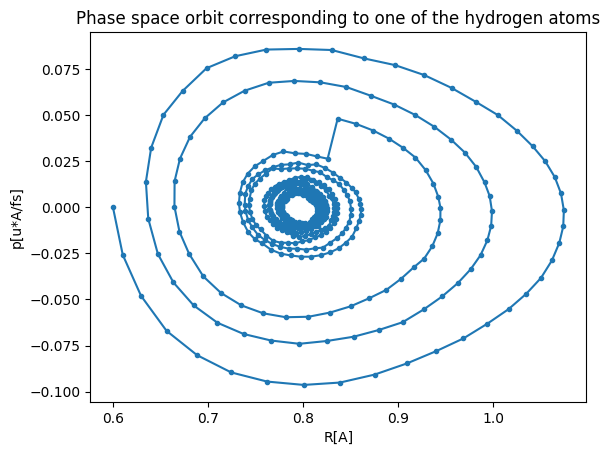

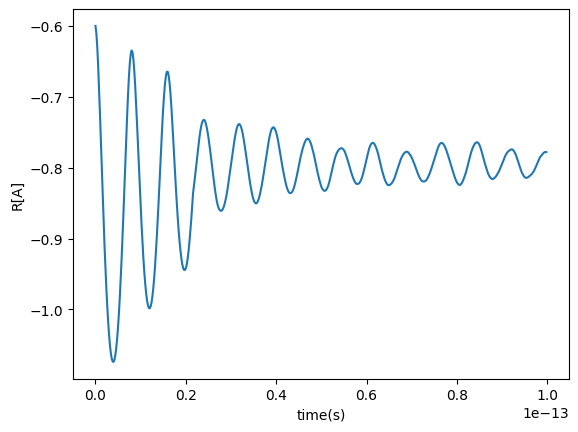

In [30]:
coords_np = np.array(coords)
momentum_np = np.array(momentum)
dist = coords_np[:,1]-coords_np[:,0]
p = momentum_np[:,0]

plt.plot(dist, p, marker='.')
plt.title('Phase space orbit corresponding to one of the hydrogen atoms')
plt.xlabel("R[A]")
plt.ylabel("p[u*A/fs]")
plt.show()

rel_dist = coords_np[:-1,0] - coords_np[:-1,1]
plt.plot(times, rel_dist)
plt.xlabel("time(s)")
plt.ylabel("R[A]")
plt.show()

In [34]:
import pandas as pd
bins = np.linspace(0.6,1,20)
# coords_np = np.array(coords)
# dist = coords_np[:,1]-coords_np[:,0]
prob = pd.cut(dist,bins)
langevin = pd.value_counts(prob, normalize=True).sort_index()
distr_langevin = []
for value in langevin:
    distr_langevin.append(value)
    
prob_diag = pd.cut(dist_diag,bins)
langevin_diag = pd.value_counts(prob_diag, normalize=True).sort_index()
distr_langevin_diag = []
for value in langevin_diag:
    distr_langevin_diag.append(value)

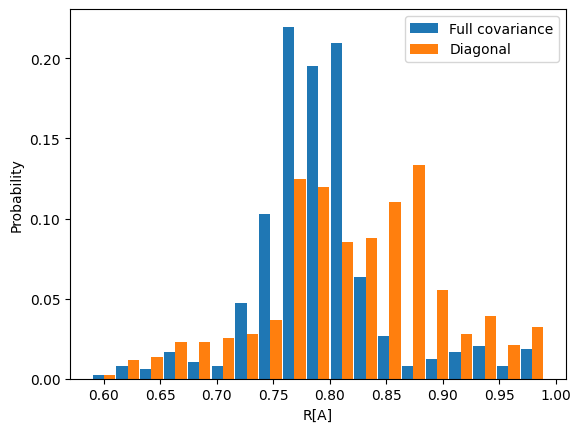

In [35]:
width = 0.01
plt.bar(np.array(bins[:-1])-width/2, np.array(distr_langevin),width=width, label="Full covariance")
plt.bar(np.array(bins[:-1])+width/2, np.array(distr_langevin_diag),width=width, label="Diagonal")
plt.xlabel("R[A]")
plt.ylabel("Probability")
plt.legend()
plt.show()

In [16]:
#Canonical
from tqdm import tqdm #to show progress

Ha = 4.36e-18
angst = 1.0e-10
dR = 0.02 # in Angstrom

femto = 1.0e-15
angst = 1.0e-10
u = 1.67e-27
#mass of particle1 (H)
mass_0 = u
#mass of particle2 (H)
mass_1 = u
mass = [mass_0, mass_1]
#time step of integrator
dt = 0.2*femto
#initial velocity of atoms
v_init = [0, 0]
# v_init = [(np.array(momentum[-1])/mass*u*angst/femto)[0], (np.array(momentum[-1])/mass*u*angst/femto)[1]]
#initial positions of atoms
init_pos = [0, 0.6]
# init_pos = coords[-1]
shots = 1024

#integrator timesteps
times = np.arange(0*femto, 100.0*femto, dt)

#k_B*T in Joule
k_B = 1.38065e-23
T = 420
k_T = k_B*T
#delta factor
delta = 8*dt

coords_diag = [init_pos]
momentum_diag = [[mass[0]/u*v_init[0]/angst*femto, mass[1]/u*v_init[1]/angst*femto]]
# pauli_op_array = np.array([])

# with Session(service=service, backend="ibmq_qasm_simulator") as session:
with Session(service=service, backend="ibmq_quito") as session:
    estimator = Estimator(session=session)
    estimator.set_options(shots=shots)
    
#     test_job = estimator.run(circuits=test_circ, observables=test_op, parameter_values=[1,1,1,1,1,1])
#     session_id = session.session_id
    
    for time in tqdm(times, desc='Progress: '):
        coordinates = coords_diag[-1]
        num_coord = len(coordinates)    
        forces = np.zeros(num_coord)
        force_ops = []
        force_op_coeffs = [] # array with dictionaries containing Pauli coefficients
        
        for i in range(num_coord):

            #get qubit operators coresponding to H+ (hamiltonian for atomic distances R + dR)
            (qubit_op_plus, num_part_plus, num_orb_plus, problem_plus, converter_plus) = get_qubit_op(coordinates[0:i]+[(coordinates[i]+dR)]+coordinates[i+1:])

            #get qubit operators coresponding to H- (hamiltonian for atomic distances R - dR)
            (qubit_op_minus, num_part_minus, num_orb_minus, problem_minus, converter_minus) = get_qubit_op(coordinates[0:i]+[(coordinates[i]-dR)]+coordinates[i+1:])


            op = (qubit_op_minus - qubit_op_plus).reduce()                  
            op_list = op.primitive.to_list() #list containing Pauli operators in support and corresponding coeffs

            force_ops.append(op)
            force_op_coeffs.append(op_list)

            if i == 0:  #we need two Pauli Ops to calculate the product and their support
                P1 = op

        if pauli_op_array.size == 0:

            pauli_op_set = {'II'} #Could not initialize empty set for some reason
            # construct set of PauliOp products that we need to calculate

            for (PauliString,coeff) in force_op_coeffs[0]:
                pauli_op_set.add(PauliString)

            #to get set of necessary PauliOp products:
                P_prod = (P1@P1).reduce()
                P_list = P_prod.primitive.to_list()

                for (PauliString,coeff) in P_list:
                    pauli_op_set.add(PauliString)

            pauli_op_array = np.array(list(pauli_op_set))

        # transform pauli strings into the form of PauliSumOp to measure them in the estimator session
        paulis_ops = []
        for PauliString in pauli_op_array:
            paulis_ops.append(PauliSumOp(SparsePauliOp(PauliString)))

        # Now we calculate the expectation values of all the relevant PauliOps   
        exp_dict = {} # dictionary with relevant expectation values

        # Calculate ground state with runtime vqe
        ops, num_part, num_orb, es_problem, converter = get_qubit_op(coordinates)
        
        psi_0,_=calc_ground_state(ops, num_part, num_orb, es_problem, converter)

        # Calculate the expectations of the Pauli strings with estimator

        paulis_exp = estimator.run(circuits=[psi_0]*len(pauli_op_array), observables=paulis_ops)

        exp_dict = {} # dictionary with relevant expectation values

        for i in range(len(pauli_op_array)):

            pauli_string = pauli_op_array[i]
            E = paulis_exp.result().values.real[i]
            exp_dict[pauli_string] = E

        for i in range(len(coordinates)):
            for (pauli_op,coeff) in force_op_coeffs[i]:
                    forces[i] += coeff.real*exp_dict[pauli_op]

        COV = np.zeros((num_coord,num_coord)) #force covariance matrix, without some multiplicative factors. 
        COV_diag = np.zeros((num_coord,num_coord)) #only diagonal terms. 

        for i in range(num_coord):
            for j in range(i,num_coord):
                Pij = (force_ops[i]@force_ops[j]).reduce()
                Pij_list = Pij.primitive.to_list()

                #add product expectation 
                for (pauli_string,coeff) in Pij_list:
                    COV[i,j] += coeff.real*exp_dict[pauli_string]
                #subtract 
                COV[i,j] -= forces[i]*forces[j]

                #since COV is symmetric
                if i < j:
                    COV[j,i] = COV[i,j] 
            COV_diag[i,i] = COV[i,i]

        forces = forces*Ha*(1/(2*dR*angst))
        COV = COV_diag*(Ha*(1/(2*dR*angst)))**2

        f0 = forces[0]
        f1 = forces[1]
                
        if time == 0:
            #get force component operators and decomposition (without the 1/(2*dR) factor, for numerical reasons) 
            v_next = v_init - delta/(2*k_T*np.sqrt(mass_0*mass_1))*np.matmul(COV,v_init)/shots*dt + np.concatenate((f0/mass_0,f1/mass_1),axis=None)*dt      
            r_next = (np.array(coordinates)*angst + dt*v_next)/angst

        else:        
            v_next += - delta/(2*k_T*np.sqrt(mass_0*mass_1))*np.matmul(COV,v_next)/shots*dt + np.concatenate((f0/mass_0,f1/mass_1),axis=None)*dt
            r_next = (np.array(coordinates)*angst + dt*v_next)/angst

        coords_diag.append([r_next[0], r_next[1]])
        momentum_diag.append([mass[0]/u*v_next[0]/angst*femto, mass[1]/u*v_next[1]/angst*femto])
        print(coords_diag)
        print(momentum_diag)

Progress:   0%|▏                                                                  | 1/500 [17:18<143:57:24, 1038.57s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994]]


Progress:   0%|▎                                                                    | 2/500 [17:37<60:41:17, 438.71s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096]]


Progress:   1%|▍                                                                    | 3/500 [17:57<34:11:08, 247.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812]]


Progress:   1%|▌                                                                    | 4/500 [18:16<21:40:50, 157.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093]]


Progress:   1%|▋                                                                    | 5/500 [18:35<14:46:49, 107.49s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353]]


Progress:   1%|▊                                                                     | 6/500 [18:55<10:38:38, 77.57s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066]]


Progress:   1%|▉                                                                      | 7/500 [19:13<7:59:30, 58.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607]]


Progress:   2%|█▏                                                                     | 8/500 [19:33<6:16:34, 45.92s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942]]


Progress:   2%|█▎                                                                     | 9/500 [19:52<5:06:31, 37.46s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942], [-0.10920283928018147, 0.10920283928018129]]


Progress:   2%|█▍                                                                    | 10/500 [20:10<4:18:49, 31.69s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942], [-0.10920283928018147, 0.10920283928018129], [-0.10491296771167043, 0.10491296771167054]]


Progress:   2%|█▌                                                                    | 11/500 [20:30<3:47:11, 27.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942], [-0.10920283928018147, 0.10920283928018129], [-0.10491296771167043, 0.10491296771167054], [-0.09801636714923222, 0.09801636714923251]]

Progress:   2%|█▋                                                                    | 12/500 [20:54<3:38:26, 26.86s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942], [-0.10920283928018147, 0.10920283928018129], [-0.10491296771167043, 0.10491296771167054], [

Progress:   3%|█▊                                                                    | 13/500 [21:13<3:17:46, 24.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942], [-0.10920283928018147, 0.10920283928018129], [-

Progress:   3%|█▉                                                                    | 14/500 [21:33<3:06:43, 23.05s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11264382493309875, 0.11264382493309942], [-0.

Progress:   3%|██                                                                    | 15/500 [21:52<2:56:47, 21.87s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.1142768310709525, 0.11427683107095607], [-0.11

Progress:   3%|██▏                                                                   | 16/500 [22:19<3:09:11, 23.45s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.1127331327500672, 0.11273313275007066], [-0.11

Progress:   3%|██▍                                                                   | 17/500 [22:39<3:00:19, 22.40s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.10492335264481116, 0.10492335264481353], [-0.112

Progress:   4%|██▌                                                                   | 18/500 [22:57<2:49:35, 21.11s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319302956214924, 0.09319302956215093], [-0.1049

Progress:   4%|██▋                                                                   | 19/500 [23:16<2:42:53, 20.32s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745502763281101, 0.077455027632812], [-0.09319

Progress:   4%|██▊                                                                   | 20/500 [23:34<2:38:42, 19.84s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.05486142322813094, 0.054861423228132096], [-0.07745

Progress:   4%|██▉                                                                   | 21/500 [23:53<2:36:33, 19.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978]]
[[0.0, 0.0], [-0.029492495446130994, 0.029492495446130994], [-0.0548614

Progress:   4%|███                                                                   | 22/500 [24:13<2:35:21, 19.50s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418]]
[[0.0, 0.0], [-0.02949249544

Progress:   5%|███▏                                                                  | 23/500 [24:33<2:36:13, 19.65s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   5%|███▎                                                                  | 24/500 [24:52<2:35:47, 19.64s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   5%|███▌                                                                  | 25/500 [25:10<2:31:40, 19.16s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   5%|███▋                                                                  | 26/500 [25:29<2:29:47, 18.96s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   5%|███▊                                                                  | 27/500 [25:48<2:29:35, 18.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   6%|███▉                                                                  | 28/500 [26:08<2:31:02, 19.20s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   6%|████                                                                  | 29/500 [26:33<2:45:27, 21.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   6%|████▏                                                                 | 30/500 [26:59<2:56:59, 22.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   6%|████▎                                                                 | 31/500 [27:25<3:04:03, 23.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   6%|████▍                                                                 | 32/500 [27:46<2:58:38, 22.90s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   7%|████▌                                                                 | 33/500 [28:04<2:47:09, 21.48s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   7%|████▊                                                                 | 34/500 [28:23<2:40:57, 20.72s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   7%|████▉                                                                 | 35/500 [28:57<3:10:13, 24.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   7%|█████                                                                 | 36/500 [30:11<5:04:31, 39.38s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   7%|█████▏                                                                | 37/500 [30:30<4:17:12, 33.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   8%|█████▎                                                                | 38/500 [30:50<3:46:42, 29.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   8%|█████▍                                                                | 39/500 [31:10<3:23:13, 26.45s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   8%|█████▌                                                                | 40/500 [31:30<3:08:32, 24.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   8%|█████▋                                                                | 41/500 [31:50<2:58:23, 23.32s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   8%|█████▉                                                                | 42/500 [32:10<2:48:54, 22.13s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   9%|██████                                                                | 43/500 [32:29<2:42:20, 21.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   9%|██████▏                                                               | 44/500 [32:49<2:37:41, 20.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   9%|██████▎                                                               | 45/500 [33:12<2:43:04, 21.51s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   9%|██████▍                                                               | 46/500 [33:31<2:38:05, 20.89s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:   9%|██████▌                                                               | 47/500 [33:51<2:33:57, 20.39s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  10%|██████▋                                                               | 48/500 [34:10<2:31:21, 20.09s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  10%|██████▊                                                               | 49/500 [34:29<2:29:18, 19.86s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  10%|███████                                                               | 50/500 [34:49<2:27:56, 19.73s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  10%|███████▏                                                              | 51/500 [35:08<2:26:49, 19.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  10%|███████▎                                                              | 52/500 [35:26<2:23:36, 19.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  11%|███████▍                                                              | 53/500 [35:51<2:35:05, 20.82s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  11%|███████▌                                                              | 54/500 [36:10<2:31:43, 20.41s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  11%|███████▋                                                              | 55/500 [36:31<2:31:02, 20.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  11%|███████▊                                                              | 56/500 [36:50<2:28:49, 20.11s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  11%|███████▉                                                              | 57/500 [37:12<2:31:38, 20.54s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  12%|████████                                                              | 58/500 [37:31<2:28:42, 20.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  12%|████████▎                                                             | 59/500 [37:50<2:25:59, 19.86s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  12%|████████▍                                                             | 60/500 [38:10<2:26:02, 19.91s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  12%|████████▌                                                             | 61/500 [38:29<2:23:33, 19.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  12%|████████▋                                                             | 62/500 [38:49<2:22:36, 19.54s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  13%|████████▊                                                             | 63/500 [39:09<2:23:32, 19.71s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  13%|████████▉                                                             | 64/500 [39:29<2:24:08, 19.84s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  13%|█████████                                                             | 65/500 [39:48<2:22:10, 19.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  13%|█████████▏                                                            | 66/500 [40:07<2:21:01, 19.50s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  13%|█████████▍                                                            | 67/500 [40:27<2:21:56, 19.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  14%|█████████▌                                                            | 68/500 [40:47<2:22:36, 19.81s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  14%|█████████▋                                                            | 69/500 [41:06<2:20:45, 19.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  14%|█████████▊                                                            | 70/500 [41:31<2:30:23, 20.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  14%|█████████▉                                                            | 71/500 [41:54<2:34:31, 21.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  14%|██████████                                                            | 72/500 [42:20<2:44:06, 23.01s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  15%|██████████▏                                                           | 73/500 [42:42<2:41:56, 22.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  15%|██████████▎                                                           | 74/500 [43:01<2:33:43, 21.65s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  15%|██████████▌                                                           | 75/500 [43:21<2:30:06, 21.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  15%|██████████▋                                                           | 76/500 [43:41<2:25:32, 20.60s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  15%|██████████▊                                                           | 77/500 [43:59<2:21:09, 20.02s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  16%|██████████▉                                                           | 78/500 [44:19<2:19:41, 19.86s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  16%|███████████                                                           | 79/500 [44:37<2:17:00, 19.53s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  16%|███████████▏                                                          | 80/500 [44:57<2:17:25, 19.63s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  16%|███████████▎                                                          | 81/500 [45:17<2:16:28, 19.54s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  16%|███████████▍                                                          | 82/500 [45:36<2:16:44, 19.63s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  17%|███████████▌                                                          | 83/500 [45:55<2:13:39, 19.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  17%|███████████▊                                                          | 84/500 [46:15<2:14:28, 19.40s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  17%|███████████▉                                                          | 85/500 [46:34<2:13:26, 19.29s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  17%|████████████                                                          | 86/500 [46:53<2:13:19, 19.32s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  17%|████████████▏                                                         | 87/500 [47:14<2:16:21, 19.81s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  18%|████████████▎                                                         | 88/500 [47:33<2:14:11, 19.54s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  18%|████████████▍                                                         | 89/500 [47:52<2:12:42, 19.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  18%|████████████▌                                                         | 90/500 [48:15<2:20:43, 20.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  18%|████████████▋                                                         | 91/500 [48:43<2:35:14, 22.77s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  18%|████████████▉                                                         | 92/500 [49:02<2:27:13, 21.65s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  19%|█████████████                                                         | 93/500 [49:21<2:21:43, 20.89s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  19%|█████████████▏                                                        | 94/500 [49:41<2:19:52, 20.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  19%|█████████████▎                                                        | 95/500 [50:00<2:15:34, 20.09s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  19%|█████████████▍                                                        | 96/500 [50:20<2:14:05, 19.91s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  19%|█████████████▌                                                        | 97/500 [50:39<2:12:20, 19.70s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  20%|█████████████▋                                                        | 98/500 [50:58<2:11:15, 19.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  20%|█████████████▊                                                        | 99/500 [51:16<2:07:58, 19.15s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  20%|█████████████▊                                                       | 100/500 [51:36<2:08:36, 19.29s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  20%|█████████████▉                                                       | 101/500 [51:54<2:06:10, 18.97s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  20%|██████████████                                                       | 102/500 [52:16<2:10:40, 19.70s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  21%|██████████████▏                                                      | 103/500 [52:34<2:07:51, 19.32s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  21%|██████████████▎                                                      | 104/500 [52:53<2:06:18, 19.14s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  21%|██████████████▍                                                      | 105/500 [53:12<2:05:46, 19.10s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  21%|██████████████▋                                                      | 106/500 [53:35<2:14:26, 20.47s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  21%|██████████████▊                                                      | 107/500 [54:03<2:28:04, 22.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  22%|██████████████▉                                                      | 108/500 [54:24<2:24:50, 22.17s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  22%|███████████████                                                      | 109/500 [54:44<2:19:13, 21.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  22%|███████████████▏                                                     | 110/500 [55:03<2:14:23, 20.68s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  22%|███████████████▎                                                     | 111/500 [55:21<2:08:53, 19.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  22%|███████████████▍                                                     | 112/500 [55:40<2:06:56, 19.63s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  23%|███████████████▌                                                     | 113/500 [55:58<2:04:33, 19.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  23%|███████████████▋                                                     | 114/500 [56:18<2:04:58, 19.43s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  23%|███████████████▊                                                     | 115/500 [56:37<2:04:25, 19.39s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  23%|████████████████                                                     | 116/500 [56:57<2:05:05, 19.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  23%|████████████████▏                                                    | 117/500 [57:15<2:01:57, 19.10s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  24%|████████████████▎                                                    | 118/500 [57:34<2:01:25, 19.07s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  24%|████████████████▍                                                    | 119/500 [57:53<1:59:25, 18.81s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  24%|████████████████▌                                                    | 120/500 [58:11<1:58:23, 18.69s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  24%|████████████████▋                                                    | 121/500 [58:30<1:57:44, 18.64s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  24%|████████████████▊                                                    | 122/500 [58:52<2:05:12, 19.87s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  25%|████████████████▉                                                    | 123/500 [59:11<2:02:16, 19.46s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  25%|█████████████████                                                    | 124/500 [59:29<1:59:30, 19.07s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  25%|█████████████████▎                                                   | 125/500 [59:48<1:59:03, 19.05s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  25%|████████████████▉                                                  | 126/500 [1:00:06<1:57:05, 18.78s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  25%|█████████████████                                                  | 127/500 [1:00:26<1:58:03, 18.99s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  26%|█████████████████▏                                                 | 128/500 [1:00:45<1:59:13, 19.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  26%|█████████████████▎                                                 | 129/500 [1:01:04<1:58:25, 19.15s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  26%|█████████████████▍                                                 | 130/500 [1:01:24<1:58:15, 19.18s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  26%|█████████████████▌                                                 | 131/500 [1:01:43<1:57:40, 19.13s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  26%|█████████████████▋                                                 | 132/500 [1:02:02<1:57:11, 19.11s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  27%|█████████████████▊                                                 | 133/500 [1:02:22<1:59:02, 19.46s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  27%|█████████████████▉                                                 | 134/500 [1:02:41<1:57:43, 19.30s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  27%|██████████████████                                                 | 135/500 [1:02:59<1:55:50, 19.04s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  27%|██████████████████▏                                                | 136/500 [1:03:20<1:58:20, 19.51s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  27%|██████████████████▎                                                | 137/500 [1:03:39<1:57:27, 19.42s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  28%|██████████████████▍                                                | 138/500 [1:03:58<1:56:28, 19.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  28%|██████████████████▋                                                | 139/500 [1:04:17<1:55:35, 19.21s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  28%|██████████████████▊                                                | 140/500 [1:04:36<1:55:15, 19.21s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  28%|██████████████████▉                                                | 141/500 [1:04:56<1:55:54, 19.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  28%|███████████████████                                                | 142/500 [1:05:18<2:00:20, 20.17s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  29%|███████████████████▏                                               | 143/500 [1:05:38<1:58:46, 19.96s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  29%|███████████████████▎                                               | 144/500 [1:05:57<1:56:56, 19.71s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  29%|███████████████████▍                                               | 145/500 [1:06:16<1:56:29, 19.69s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  29%|███████████████████▌                                               | 146/500 [1:06:37<1:57:01, 19.84s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  29%|███████████████████▋                                               | 147/500 [1:06:56<1:56:05, 19.73s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  30%|███████████████████▊                                               | 148/500 [1:07:17<1:57:23, 20.01s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  30%|███████████████████▉                                               | 149/500 [1:07:36<1:55:45, 19.79s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  30%|████████████████████                                               | 150/500 [1:08:02<2:06:28, 21.68s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  30%|████████████████████▏                                              | 151/500 [1:08:25<2:08:51, 22.15s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  30%|████████████████████▎                                              | 152/500 [1:08:46<2:05:58, 21.72s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  31%|████████████████████▌                                              | 153/500 [1:09:06<2:03:21, 21.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  31%|████████████████████▋                                              | 154/500 [1:09:26<2:00:23, 20.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  31%|████████████████████▊                                              | 155/500 [1:09:45<1:56:51, 20.32s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  31%|████████████████████▉                                              | 156/500 [1:10:05<1:55:09, 20.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  31%|█████████████████████                                              | 157/500 [1:10:24<1:52:33, 19.69s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  32%|█████████████████████▏                                             | 158/500 [1:10:43<1:51:11, 19.51s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  32%|█████████████████████▎                                             | 159/500 [1:11:02<1:50:08, 19.38s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  32%|█████████████████████▍                                             | 160/500 [1:11:21<1:49:49, 19.38s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  32%|█████████████████████▌                                             | 161/500 [1:11:40<1:48:55, 19.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  32%|█████████████████████▋                                             | 162/500 [1:11:59<1:48:05, 19.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  33%|█████████████████████▊                                             | 163/500 [1:12:19<1:48:51, 19.38s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  33%|█████████████████████▉                                             | 164/500 [1:12:37<1:46:35, 19.03s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  33%|██████████████████████                                             | 165/500 [1:12:56<1:45:14, 18.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  33%|██████████████████████▏                                            | 166/500 [1:13:15<1:45:04, 18.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  33%|██████████████████████▍                                            | 167/500 [1:13:35<1:46:45, 19.24s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  34%|██████████████████████▌                                            | 168/500 [1:13:54<1:45:59, 19.16s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  34%|██████████████████████▋                                            | 169/500 [1:14:13<1:46:09, 19.24s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  34%|██████████████████████▊                                            | 170/500 [1:14:32<1:44:46, 19.05s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  34%|██████████████████████▉                                            | 171/500 [1:14:52<1:46:06, 19.35s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  34%|███████████████████████                                            | 172/500 [1:15:11<1:45:33, 19.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  35%|███████████████████████▏                                           | 173/500 [1:15:30<1:44:44, 19.22s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  35%|███████████████████████▎                                           | 174/500 [1:15:49<1:44:01, 19.15s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  35%|███████████████████████▍                                           | 175/500 [1:16:08<1:44:19, 19.26s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  35%|███████████████████████▌                                           | 176/500 [1:16:28<1:44:57, 19.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  35%|███████████████████████▋                                           | 177/500 [1:16:53<1:53:31, 21.09s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  36%|███████████████████████▊                                           | 178/500 [1:17:13<1:50:31, 20.60s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  36%|███████████████████████▉                                           | 179/500 [1:17:32<1:47:24, 20.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  36%|████████████████████████                                           | 180/500 [1:17:51<1:45:27, 19.77s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  36%|████████████████████████▎                                          | 181/500 [1:18:10<1:44:51, 19.72s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  36%|████████████████████████▍                                          | 182/500 [1:18:30<1:44:38, 19.74s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  37%|████████████████████████▌                                          | 183/500 [1:18:49<1:43:47, 19.65s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  37%|████████████████████████▋                                          | 184/500 [1:19:09<1:43:11, 19.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  37%|████████████████████████▊                                          | 185/500 [1:19:29<1:43:55, 19.79s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  37%|████████████████████████▉                                          | 186/500 [1:19:54<1:51:05, 21.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  37%|█████████████████████████                                          | 187/500 [1:20:13<1:47:25, 20.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  38%|█████████████████████████▏                                         | 188/500 [1:20:33<1:45:43, 20.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  38%|█████████████████████████▎                                         | 189/500 [1:20:52<1:43:44, 20.01s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  38%|█████████████████████████▍                                         | 190/500 [1:21:11<1:42:41, 19.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  38%|█████████████████████████▌                                         | 191/500 [1:21:30<1:40:51, 19.58s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  38%|█████████████████████████▋                                         | 192/500 [1:22:42<3:00:29, 35.16s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  39%|█████████████████████████▊                                         | 193/500 [1:23:03<2:38:38, 31.01s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  39%|█████████████████████████▉                                         | 194/500 [1:23:23<2:21:05, 27.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  39%|██████████████████████████▏                                        | 195/500 [1:23:44<2:10:19, 25.64s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  39%|██████████████████████████▎                                        | 196/500 [1:24:09<2:09:45, 25.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  39%|██████████████████████████▍                                        | 197/500 [1:25:04<2:52:58, 34.25s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  40%|██████████████████████████▌                                        | 198/500 [1:25:35<2:47:04, 33.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  40%|██████████████████████████▋                                        | 199/500 [1:26:11<2:51:30, 34.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  40%|██████████████████████████▊                                        | 200/500 [1:26:59<3:11:48, 38.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  40%|██████████████████████████▉                                        | 201/500 [1:27:26<2:54:22, 34.99s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  40%|███████████████████████████                                        | 202/500 [1:27:52<2:39:25, 32.10s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  41%|███████████████████████████▏                                       | 203/500 [1:28:11<2:20:14, 28.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  41%|███████████████████████████▎                                       | 204/500 [1:28:31<2:06:28, 25.64s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  41%|███████████████████████████▍                                       | 205/500 [1:28:49<1:56:01, 23.60s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  41%|███████████████████████████▌                                       | 206/500 [1:29:10<1:51:10, 22.69s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  41%|███████████████████████████▋                                       | 207/500 [1:29:29<1:44:52, 21.48s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  42%|███████████████████████████▊                                       | 208/500 [1:29:49<1:42:34, 21.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  42%|████████████████████████████                                       | 209/500 [1:30:08<1:39:36, 20.54s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  42%|████████████████████████████▏                                      | 210/500 [1:30:28<1:38:23, 20.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  42%|████████████████████████████▎                                      | 211/500 [1:30:48<1:37:39, 20.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  42%|████████████████████████████▍                                      | 212/500 [1:31:07<1:36:07, 20.03s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  43%|████████████████████████████▌                                      | 213/500 [1:31:27<1:35:26, 19.95s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  43%|████████████████████████████▋                                      | 214/500 [1:31:47<1:34:12, 19.76s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  43%|████████████████████████████▊                                      | 215/500 [1:32:11<1:40:24, 21.14s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  43%|████████████████████████████▉                                      | 216/500 [1:32:29<1:36:16, 20.34s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  43%|█████████████████████████████                                      | 217/500 [1:32:49<1:34:53, 20.12s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  44%|█████████████████████████████▏                                     | 218/500 [1:33:08<1:32:48, 19.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  44%|█████████████████████████████▎                                     | 219/500 [1:33:28<1:32:57, 19.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  44%|█████████████████████████████▍                                     | 220/500 [1:33:51<1:36:25, 20.66s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  44%|█████████████████████████████▌                                     | 221/500 [1:34:11<1:35:44, 20.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  44%|█████████████████████████████▋                                     | 222/500 [1:34:31<1:35:18, 20.57s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  45%|█████████████████████████████▉                                     | 223/500 [1:34:57<1:41:35, 22.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  45%|██████████████████████████████                                     | 224/500 [1:35:16<1:37:33, 21.21s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  45%|██████████████████████████████▏                                    | 225/500 [1:35:36<1:34:50, 20.69s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  45%|██████████████████████████████▎                                    | 226/500 [1:35:56<1:33:21, 20.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  45%|██████████████████████████████▍                                    | 227/500 [1:36:16<1:33:02, 20.45s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  46%|██████████████████████████████▌                                    | 228/500 [1:36:37<1:33:16, 20.58s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  46%|██████████████████████████████▋                                    | 229/500 [1:36:56<1:31:04, 20.16s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  46%|██████████████████████████████▊                                    | 230/500 [1:37:16<1:30:34, 20.13s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  46%|██████████████████████████████▉                                    | 231/500 [1:37:36<1:30:30, 20.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  46%|███████████████████████████████                                    | 232/500 [1:37:56<1:28:43, 19.86s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  47%|███████████████████████████████▏                                   | 233/500 [1:38:15<1:27:57, 19.77s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  47%|███████████████████████████████▎                                   | 234/500 [1:38:34<1:26:45, 19.57s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  47%|███████████████████████████████▍                                   | 235/500 [1:38:54<1:26:21, 19.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  47%|███████████████████████████████▌                                   | 236/500 [1:39:14<1:26:52, 19.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  47%|███████████████████████████████▊                                   | 237/500 [1:39:34<1:26:23, 19.71s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  48%|███████████████████████████████▉                                   | 238/500 [1:40:00<1:34:25, 21.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  48%|████████████████████████████████                                   | 239/500 [1:40:19<1:30:49, 20.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  48%|████████████████████████████████▏                                  | 240/500 [1:40:39<1:29:06, 20.56s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  48%|████████████████████████████████▎                                  | 241/500 [1:40:58<1:27:45, 20.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  48%|████████████████████████████████▍                                  | 242/500 [1:41:18<1:27:10, 20.27s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  49%|████████████████████████████████▌                                  | 243/500 [1:41:38<1:25:13, 19.90s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  49%|████████████████████████████████▋                                  | 244/500 [1:41:57<1:24:16, 19.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  49%|████████████████████████████████▊                                  | 245/500 [1:42:16<1:23:32, 19.66s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  49%|████████████████████████████████▉                                  | 246/500 [1:42:37<1:23:56, 19.83s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  49%|█████████████████████████████████                                  | 247/500 [1:42:57<1:24:20, 20.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  50%|█████████████████████████████████▏                                 | 248/500 [1:43:16<1:23:12, 19.81s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  50%|█████████████████████████████████▎                                 | 249/500 [1:43:36<1:22:58, 19.83s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  50%|█████████████████████████████████▌                                 | 250/500 [1:43:57<1:24:05, 20.18s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  50%|█████████████████████████████████▋                                 | 251/500 [1:44:17<1:23:47, 20.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  50%|█████████████████████████████████▊                                 | 252/500 [1:44:38<1:24:28, 20.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  51%|█████████████████████████████████▉                                 | 253/500 [1:44:59<1:23:48, 20.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  51%|██████████████████████████████████                                 | 254/500 [1:45:18<1:21:57, 19.99s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  51%|██████████████████████████████████▏                                | 255/500 [1:45:37<1:20:34, 19.73s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  51%|██████████████████████████████████▎                                | 256/500 [1:45:57<1:20:32, 19.80s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  51%|██████████████████████████████████▍                                | 257/500 [1:46:19<1:22:27, 20.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  52%|██████████████████████████████████▌                                | 258/500 [1:46:38<1:21:19, 20.16s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  52%|██████████████████████████████████▋                                | 259/500 [1:46:59<1:21:18, 20.24s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  52%|██████████████████████████████████▊                                | 260/500 [1:47:19<1:20:33, 20.14s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  52%|██████████████████████████████████▉                                | 261/500 [1:47:38<1:19:55, 20.06s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  52%|███████████████████████████████████                                | 262/500 [1:47:59<1:19:47, 20.11s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  53%|███████████████████████████████████▏                               | 263/500 [1:48:18<1:18:54, 19.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  53%|███████████████████████████████████▍                               | 264/500 [1:48:38<1:18:05, 19.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  53%|███████████████████████████████████▌                               | 265/500 [1:48:59<1:19:05, 20.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  53%|███████████████████████████████████▋                               | 266/500 [1:49:18<1:17:46, 19.94s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  53%|███████████████████████████████████▊                               | 267/500 [1:49:37<1:16:30, 19.70s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  54%|███████████████████████████████████▉                               | 268/500 [1:49:58<1:17:36, 20.07s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  54%|████████████████████████████████████                               | 269/500 [1:50:18<1:16:25, 19.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  54%|████████████████████████████████████▏                              | 270/500 [1:50:37<1:16:04, 19.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  54%|████████████████████████████████████▎                              | 271/500 [1:50:58<1:16:07, 19.95s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  54%|████████████████████████████████████▍                              | 272/500 [1:51:18<1:15:58, 19.99s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  55%|████████████████████████████████████▌                              | 273/500 [1:51:38<1:15:30, 19.96s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  55%|████████████████████████████████████▋                              | 274/500 [1:51:58<1:15:16, 19.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  55%|████████████████████████████████████▊                              | 275/500 [1:52:17<1:14:28, 19.86s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  55%|████████████████████████████████████▉                              | 276/500 [1:52:39<1:16:14, 20.42s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  55%|█████████████████████████████████████                              | 277/500 [1:52:58<1:14:37, 20.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  56%|█████████████████████████████████████▎                             | 278/500 [1:53:18<1:14:17, 20.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  56%|█████████████████████████████████████▍                             | 279/500 [1:53:39<1:14:16, 20.17s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  56%|█████████████████████████████████████▌                             | 280/500 [1:53:58<1:13:25, 20.03s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  56%|█████████████████████████████████████▋                             | 281/500 [1:54:19<1:13:23, 20.11s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  56%|█████████████████████████████████████▊                             | 282/500 [1:54:39<1:13:03, 20.11s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  57%|█████████████████████████████████████▉                             | 283/500 [1:54:59<1:12:47, 20.13s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  57%|██████████████████████████████████████                             | 284/500 [1:55:20<1:13:13, 20.34s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  57%|██████████████████████████████████████▏                            | 285/500 [1:55:40<1:13:06, 20.40s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  57%|██████████████████████████████████████▎                            | 286/500 [1:56:06<1:18:03, 21.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  57%|██████████████████████████████████████▍                            | 287/500 [1:56:26<1:16:08, 21.45s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  58%|██████████████████████████████████████▌                            | 288/500 [1:56:45<1:12:44, 20.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  58%|██████████████████████████████████████▋                            | 289/500 [1:57:05<1:11:45, 20.41s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  58%|██████████████████████████████████████▊                            | 290/500 [1:57:26<1:11:49, 20.52s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  58%|██████████████████████████████████████▉                            | 291/500 [1:57:45<1:10:37, 20.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  58%|███████████████████████████████████████▏                           | 292/500 [1:58:07<1:11:54, 20.74s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  59%|███████████████████████████████████████▎                           | 293/500 [1:58:28<1:11:24, 20.70s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  59%|███████████████████████████████████████▍                           | 294/500 [1:58:48<1:10:48, 20.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  59%|███████████████████████████████████████▌                           | 295/500 [1:59:08<1:09:57, 20.48s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  59%|███████████████████████████████████████▋                           | 296/500 [1:59:29<1:09:37, 20.48s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  59%|███████████████████████████████████████▊                           | 297/500 [1:59:49<1:09:05, 20.42s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  60%|███████████████████████████████████████▉                           | 298/500 [2:00:10<1:09:29, 20.64s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  60%|████████████████████████████████████████                           | 299/500 [2:00:31<1:09:04, 20.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  60%|████████████████████████████████████████▏                          | 300/500 [2:00:50<1:07:25, 20.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  60%|████████████████████████████████████████▎                          | 301/500 [2:01:09<1:06:06, 19.93s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  60%|████████████████████████████████████████▍                          | 302/500 [2:01:29<1:06:00, 20.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  61%|████████████████████████████████████████▌                          | 303/500 [2:01:50<1:05:59, 20.10s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  61%|████████████████████████████████████████▋                          | 304/500 [2:02:10<1:05:56, 20.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  61%|████████████████████████████████████████▊                          | 305/500 [2:02:31<1:06:22, 20.42s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  61%|█████████████████████████████████████████                          | 306/500 [2:02:52<1:06:25, 20.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  61%|█████████████████████████████████████████▏                         | 307/500 [2:03:12<1:05:26, 20.34s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  62%|█████████████████████████████████████████▎                         | 308/500 [2:03:33<1:05:36, 20.50s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  62%|█████████████████████████████████████████▍                         | 309/500 [2:03:52<1:04:16, 20.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  62%|█████████████████████████████████████████▌                         | 310/500 [2:04:12<1:03:13, 19.96s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  62%|█████████████████████████████████████████▋                         | 311/500 [2:04:32<1:03:19, 20.10s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  62%|█████████████████████████████████████████▊                         | 312/500 [2:04:53<1:04:12, 20.49s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  63%|█████████████████████████████████████████▉                         | 313/500 [2:05:14<1:03:43, 20.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  63%|██████████████████████████████████████████                         | 314/500 [2:05:33<1:02:22, 20.12s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  63%|██████████████████████████████████████████▏                        | 315/500 [2:05:58<1:06:11, 21.47s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  63%|██████████████████████████████████████████▎                        | 316/500 [2:06:18<1:04:22, 20.99s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  63%|██████████████████████████████████████████▍                        | 317/500 [2:06:37<1:02:59, 20.65s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  64%|██████████████████████████████████████████▌                        | 318/500 [2:06:58<1:02:31, 20.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  64%|██████████████████████████████████████████▋                        | 319/500 [2:07:18<1:01:25, 20.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  64%|██████████████████████████████████████████▉                        | 320/500 [2:07:38<1:00:32, 20.18s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  64%|███████████████████████████████████████████                        | 321/500 [2:07:58<1:00:31, 20.29s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  64%|███████████████████████████████████████████▏                       | 322/500 [2:08:19<1:00:22, 20.35s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  65%|████████████████████████████████████████████▌                        | 323/500 [2:08:39<59:40, 20.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  65%|████████████████████████████████████████████▋                        | 324/500 [2:08:58<58:40, 20.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  65%|████████████████████████████████████████████▊                        | 325/500 [2:09:17<57:35, 19.74s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  65%|████████████████████████████████████████████▉                        | 326/500 [2:09:38<58:23, 20.14s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  65%|█████████████████████████████████████████████▏                       | 327/500 [2:09:58<58:00, 20.12s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  66%|█████████████████████████████████████████████▎                       | 328/500 [2:10:17<56:52, 19.84s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  66%|█████████████████████████████████████████████▍                       | 329/500 [2:10:37<56:21, 19.77s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  66%|█████████████████████████████████████████████▌                       | 330/500 [2:10:56<55:06, 19.45s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  66%|█████████████████████████████████████████████▋                       | 331/500 [2:11:16<55:42, 19.78s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  66%|█████████████████████████████████████████████▊                       | 332/500 [2:11:36<55:40, 19.88s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  67%|█████████████████████████████████████████████▉                       | 333/500 [2:11:56<55:10, 19.82s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  67%|██████████████████████████████████████████████                       | 334/500 [2:12:17<55:30, 20.06s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  67%|██████████████████████████████████████████████▏                      | 335/500 [2:12:37<55:14, 20.09s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  67%|██████████████████████████████████████████████▎                      | 336/500 [2:12:58<55:59, 20.49s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  67%|██████████████████████████████████████████████▌                      | 337/500 [2:13:18<55:14, 20.34s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  68%|██████████████████████████████████████████████▋                      | 338/500 [2:13:39<55:22, 20.51s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  68%|██████████████████████████████████████████████▊                      | 339/500 [2:14:00<55:29, 20.68s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  68%|██████████████████████████████████████████████▉                      | 340/500 [2:14:21<55:27, 20.80s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  68%|███████████████████████████████████████████████                      | 341/500 [2:14:41<54:01, 20.39s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  68%|███████████████████████████████████████████████▏                     | 342/500 [2:15:02<54:11, 20.58s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  69%|███████████████████████████████████████████████▎                     | 343/500 [2:15:22<53:34, 20.47s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  69%|███████████████████████████████████████████████▍                     | 344/500 [2:15:43<53:31, 20.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  69%|███████████████████████████████████████████████▌                     | 345/500 [2:16:04<53:37, 20.76s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  69%|███████████████████████████████████████████████▋                     | 346/500 [2:16:23<52:14, 20.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  69%|███████████████████████████████████████████████▉                     | 347/500 [2:16:43<51:01, 20.01s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  70%|████████████████████████████████████████████████                     | 348/500 [2:17:02<50:28, 19.92s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  70%|████████████████████████████████████████████████▏                    | 349/500 [2:17:22<49:53, 19.82s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  70%|████████████████████████████████████████████████▎                    | 350/500 [2:17:42<50:00, 20.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  70%|████████████████████████████████████████████████▍                    | 351/500 [2:18:03<50:16, 20.25s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  70%|████████████████████████████████████████████████▌                    | 352/500 [2:18:24<50:06, 20.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  71%|████████████████████████████████████████████████▋                    | 353/500 [2:18:45<50:14, 20.50s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  71%|████████████████████████████████████████████████▊                    | 354/500 [2:19:05<49:34, 20.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  71%|████████████████████████████████████████████████▉                    | 355/500 [2:19:25<49:13, 20.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  71%|█████████████████████████████████████████████████▏                   | 356/500 [2:19:53<54:24, 22.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  71%|█████████████████████████████████████████████████▎                   | 357/500 [2:20:14<52:27, 22.01s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  72%|█████████████████████████████████████████████████▍                   | 358/500 [2:20:34<51:17, 21.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  72%|█████████████████████████████████████████████████▌                   | 359/500 [2:20:55<49:52, 21.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  72%|█████████████████████████████████████████████████▋                   | 360/500 [2:21:17<50:04, 21.46s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  72%|█████████████████████████████████████████████████▊                   | 361/500 [2:21:49<57:23, 24.77s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  72%|████████████████████████████████████████████████▌                  | 362/500 [2:22:29<1:07:38, 29.41s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  73%|████████████████████████████████████████████████▋                  | 363/500 [2:22:49<1:00:44, 26.60s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  73%|██████████████████████████████████████████████████▏                  | 364/500 [2:23:09<55:46, 24.60s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  73%|██████████████████████████████████████████████████▎                  | 365/500 [2:23:30<52:30, 23.34s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  73%|██████████████████████████████████████████████████▌                  | 366/500 [2:23:50<49:57, 22.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  73%|██████████████████████████████████████████████████▋                  | 367/500 [2:24:10<47:53, 21.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  74%|██████████████████████████████████████████████████▊                  | 368/500 [2:24:30<46:46, 21.26s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  74%|██████████████████████████████████████████████████▉                  | 369/500 [2:24:51<46:07, 21.12s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  74%|███████████████████████████████████████████████████                  | 370/500 [2:25:12<45:45, 21.12s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  74%|███████████████████████████████████████████████████▏                 | 371/500 [2:25:32<44:48, 20.84s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  74%|███████████████████████████████████████████████████▎                 | 372/500 [2:25:52<43:57, 20.60s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  75%|███████████████████████████████████████████████████▍                 | 373/500 [2:26:13<43:39, 20.63s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  75%|███████████████████████████████████████████████████▌                 | 374/500 [2:26:34<43:28, 20.71s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  75%|███████████████████████████████████████████████████▊                 | 375/500 [2:26:55<43:25, 20.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  75%|███████████████████████████████████████████████████▉                 | 376/500 [2:27:15<42:24, 20.52s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  75%|████████████████████████████████████████████████████                 | 377/500 [2:27:35<41:34, 20.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  76%|████████████████████████████████████████████████████▏                | 378/500 [2:28:00<44:39, 21.96s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  76%|████████████████████████████████████████████████████▎                | 379/500 [2:28:22<43:50, 21.74s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  76%|████████████████████████████████████████████████████▍                | 380/500 [2:28:43<43:28, 21.73s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  76%|████████████████████████████████████████████████████▌                | 381/500 [2:29:04<42:17, 21.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  76%|████████████████████████████████████████████████████▋                | 382/500 [2:29:25<41:42, 21.21s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  77%|████████████████████████████████████████████████████▊                | 383/500 [2:29:44<40:31, 20.78s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  77%|████████████████████████████████████████████████████▉                | 384/500 [2:30:05<40:14, 20.81s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  77%|█████████████████████████████████████████████████████▏               | 385/500 [2:30:31<42:24, 22.13s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  77%|█████████████████████████████████████████████████████▎               | 386/500 [2:30:51<41:04, 21.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  77%|█████████████████████████████████████████████████████▍               | 387/500 [2:31:11<40:05, 21.29s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  78%|█████████████████████████████████████████████████████▌               | 388/500 [2:31:34<40:38, 21.78s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  78%|█████████████████████████████████████████████████████▋               | 389/500 [2:32:14<50:15, 27.17s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  78%|████████████████████████████████████████████████████▎              | 390/500 [2:33:07<1:03:50, 34.82s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  78%|████████████████████████████████████████████████████▍              | 391/500 [2:34:31<1:30:10, 49.64s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  78%|████████████████████████████████████████████████████▌              | 392/500 [2:34:49<1:12:30, 40.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  79%|██████████████████████████████████████████████████████▏              | 393/500 [2:35:08<59:56, 33.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  79%|██████████████████████████████████████████████████████▎              | 394/500 [2:35:27<51:40, 29.25s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  79%|██████████████████████████████████████████████████████▌              | 395/500 [2:35:45<45:20, 25.91s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  79%|██████████████████████████████████████████████████████▋              | 396/500 [2:36:02<40:22, 23.30s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  79%|██████████████████████████████████████████████████████▊              | 397/500 [2:36:21<37:47, 22.02s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  80%|██████████████████████████████████████████████████████▉              | 398/500 [2:36:39<35:38, 20.97s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  80%|███████████████████████████████████████████████████████              | 399/500 [2:36:57<33:38, 19.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  80%|███████████████████████████████████████████████████████▏             | 400/500 [2:37:15<32:16, 19.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  80%|███████████████████████████████████████████████████████▎             | 401/500 [2:37:33<31:15, 18.95s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  80%|███████████████████████████████████████████████████████▍             | 402/500 [2:37:50<30:04, 18.41s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  81%|███████████████████████████████████████████████████████▌             | 403/500 [2:38:08<29:34, 18.29s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  81%|███████████████████████████████████████████████████████▊             | 404/500 [2:38:26<29:09, 18.22s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  81%|███████████████████████████████████████████████████████▉             | 405/500 [2:38:45<29:14, 18.47s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  81%|████████████████████████████████████████████████████████             | 406/500 [2:39:03<28:45, 18.35s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  81%|████████████████████████████████████████████████████████▏            | 407/500 [2:39:21<27:58, 18.05s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  82%|████████████████████████████████████████████████████████▎            | 408/500 [2:39:39<27:34, 17.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  82%|████████████████████████████████████████████████████████▍            | 409/500 [2:39:57<27:20, 18.03s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  82%|████████████████████████████████████████████████████████▌            | 410/500 [2:40:15<27:00, 18.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  82%|████████████████████████████████████████████████████████▋            | 411/500 [2:40:33<26:44, 18.03s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  82%|████████████████████████████████████████████████████████▊            | 412/500 [2:40:52<26:54, 18.35s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  83%|████████████████████████████████████████████████████████▉            | 413/500 [2:41:10<26:31, 18.30s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  83%|█████████████████████████████████████████████████████████▏           | 414/500 [2:41:28<26:07, 18.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  83%|█████████████████████████████████████████████████████████▎           | 415/500 [2:41:46<25:53, 18.27s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  83%|█████████████████████████████████████████████████████████▍           | 416/500 [2:42:05<25:30, 18.22s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  83%|█████████████████████████████████████████████████████████▌           | 417/500 [2:42:23<25:09, 18.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  84%|█████████████████████████████████████████████████████████▋           | 418/500 [2:42:41<24:54, 18.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  84%|█████████████████████████████████████████████████████████▊           | 419/500 [2:42:58<24:16, 17.99s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  84%|█████████████████████████████████████████████████████████▉           | 420/500 [2:43:16<23:46, 17.83s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  84%|██████████████████████████████████████████████████████████           | 421/500 [2:43:34<23:24, 17.78s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  84%|██████████████████████████████████████████████████████████▏          | 422/500 [2:43:52<23:28, 18.06s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  85%|██████████████████████████████████████████████████████████▎          | 423/500 [2:44:10<22:57, 17.89s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  85%|██████████████████████████████████████████████████████████▌          | 424/500 [2:44:27<22:31, 17.79s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  85%|██████████████████████████████████████████████████████████▋          | 425/500 [2:44:44<21:57, 17.56s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  85%|██████████████████████████████████████████████████████████▊          | 426/500 [2:45:02<21:38, 17.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  85%|██████████████████████████████████████████████████████████▉          | 427/500 [2:45:20<21:23, 17.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  86%|███████████████████████████████████████████████████████████          | 428/500 [2:45:37<21:12, 17.68s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  86%|███████████████████████████████████████████████████████████▏         | 429/500 [2:45:55<20:53, 17.66s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  86%|███████████████████████████████████████████████████████████▎         | 430/500 [2:46:14<20:54, 17.92s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  86%|███████████████████████████████████████████████████████████▍         | 431/500 [2:46:31<20:30, 17.83s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  86%|███████████████████████████████████████████████████████████▌         | 432/500 [2:46:49<20:12, 17.83s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  87%|███████████████████████████████████████████████████████████▊         | 433/500 [2:47:07<20:05, 18.00s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  87%|███████████████████████████████████████████████████████████▉         | 434/500 [2:47:26<20:08, 18.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  87%|████████████████████████████████████████████████████████████         | 435/500 [2:47:45<20:03, 18.52s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  87%|████████████████████████████████████████████████████████████▏        | 436/500 [2:48:03<19:36, 18.38s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  87%|████████████████████████████████████████████████████████████▎        | 437/500 [2:48:22<19:14, 18.32s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  88%|████████████████████████████████████████████████████████████▍        | 438/500 [2:48:39<18:45, 18.15s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  88%|████████████████████████████████████████████████████████████▌        | 439/500 [2:48:57<18:11, 17.89s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  88%|████████████████████████████████████████████████████████████▋        | 440/500 [2:49:15<18:01, 18.02s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  88%|████████████████████████████████████████████████████████████▊        | 441/500 [2:49:34<18:00, 18.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  88%|████████████████████████████████████████████████████████████▉        | 442/500 [2:49:52<17:37, 18.24s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  89%|█████████████████████████████████████████████████████████████▏       | 443/500 [2:50:09<16:57, 17.85s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  89%|█████████████████████████████████████████████████████████████▎       | 444/500 [2:50:26<16:26, 17.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  89%|█████████████████████████████████████████████████████████████▍       | 445/500 [2:50:44<16:07, 17.58s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  89%|█████████████████████████████████████████████████████████████▌       | 446/500 [2:51:01<15:50, 17.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  89%|█████████████████████████████████████████████████████████████▋       | 447/500 [2:51:22<16:17, 18.43s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  90%|█████████████████████████████████████████████████████████████▊       | 448/500 [2:51:40<15:54, 18.36s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  90%|█████████████████████████████████████████████████████████████▉       | 449/500 [2:51:57<15:24, 18.14s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  90%|██████████████████████████████████████████████████████████████       | 450/500 [2:52:16<15:08, 18.17s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  90%|██████████████████████████████████████████████████████████████▏      | 451/500 [2:52:34<14:53, 18.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  90%|██████████████████████████████████████████████████████████████▍      | 452/500 [2:52:52<14:24, 18.02s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  91%|██████████████████████████████████████████████████████████████▌      | 453/500 [2:53:09<13:55, 17.77s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  91%|██████████████████████████████████████████████████████████████▋      | 454/500 [2:53:27<13:44, 17.92s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  91%|██████████████████████████████████████████████████████████████▊      | 455/500 [2:53:45<13:32, 18.06s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  91%|██████████████████████████████████████████████████████████████▉      | 456/500 [2:54:03<13:11, 17.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  91%|███████████████████████████████████████████████████████████████      | 457/500 [2:54:21<12:52, 17.95s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  92%|███████████████████████████████████████████████████████████████▏     | 458/500 [2:54:38<12:25, 17.74s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  92%|███████████████████████████████████████████████████████████████▎     | 459/500 [2:54:56<12:07, 17.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  92%|███████████████████████████████████████████████████████████████▍     | 460/500 [2:55:15<11:57, 17.94s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  92%|███████████████████████████████████████████████████████████████▌     | 461/500 [2:55:33<11:43, 18.04s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  92%|███████████████████████████████████████████████████████████████▊     | 462/500 [2:55:50<11:12, 17.70s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  93%|███████████████████████████████████████████████████████████████▉     | 463/500 [2:56:08<10:59, 17.83s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  93%|████████████████████████████████████████████████████████████████     | 464/500 [2:56:25<10:34, 17.62s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  93%|████████████████████████████████████████████████████████████████▏    | 465/500 [2:56:43<10:18, 17.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  93%|████████████████████████████████████████████████████████████████▎    | 466/500 [2:57:01<10:04, 17.79s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  93%|████████████████████████████████████████████████████████████████▍    | 467/500 [2:57:19<09:47, 17.81s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  94%|████████████████████████████████████████████████████████████████▌    | 468/500 [2:57:38<09:45, 18.30s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  94%|████████████████████████████████████████████████████████████████▋    | 469/500 [2:57:56<09:25, 18.23s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  94%|████████████████████████████████████████████████████████████████▊    | 470/500 [2:58:15<09:16, 18.55s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  94%|████████████████████████████████████████████████████████████████▉    | 471/500 [2:58:35<09:03, 18.75s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  94%|█████████████████████████████████████████████████████████████████▏   | 472/500 [2:58:53<08:42, 18.67s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  95%|█████████████████████████████████████████████████████████████████▎   | 473/500 [2:59:11<08:16, 18.37s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  95%|█████████████████████████████████████████████████████████████████▍   | 474/500 [2:59:30<08:01, 18.51s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  95%|█████████████████████████████████████████████████████████████████▌   | 475/500 [2:59:48<07:40, 18.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  95%|█████████████████████████████████████████████████████████████████▋   | 476/500 [3:00:07<07:25, 18.58s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  95%|█████████████████████████████████████████████████████████████████▊   | 477/500 [3:00:25<07:07, 18.59s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  96%|█████████████████████████████████████████████████████████████████▉   | 478/500 [3:00:44<06:45, 18.44s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  96%|██████████████████████████████████████████████████████████████████   | 479/500 [3:01:02<06:29, 18.53s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  96%|██████████████████████████████████████████████████████████████████▏  | 480/500 [3:01:20<06:03, 18.19s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  96%|██████████████████████████████████████████████████████████████████▍  | 481/500 [3:01:37<05:38, 17.84s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  96%|██████████████████████████████████████████████████████████████████▌  | 482/500 [3:01:55<05:25, 18.08s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  97%|██████████████████████████████████████████████████████████████████▋  | 483/500 [3:02:14<05:07, 18.10s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  97%|██████████████████████████████████████████████████████████████████▊  | 484/500 [3:02:33<04:54, 18.41s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  97%|██████████████████████████████████████████████████████████████████▉  | 485/500 [3:02:50<04:29, 17.98s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  97%|███████████████████████████████████████████████████████████████████  | 486/500 [3:03:08<04:14, 18.17s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  97%|███████████████████████████████████████████████████████████████████▏ | 487/500 [3:03:27<03:59, 18.43s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  98%|███████████████████████████████████████████████████████████████████▎ | 488/500 [3:03:46<03:41, 18.46s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  98%|███████████████████████████████████████████████████████████████████▍ | 489/500 [3:04:06<03:28, 18.95s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  98%|███████████████████████████████████████████████████████████████████▌ | 490/500 [3:04:24<03:06, 18.61s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  98%|███████████████████████████████████████████████████████████████████▊ | 491/500 [3:04:42<02:45, 18.41s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  98%|███████████████████████████████████████████████████████████████████▉ | 492/500 [3:05:00<02:26, 18.33s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  99%|████████████████████████████████████████████████████████████████████ | 493/500 [3:05:19<02:10, 18.57s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  99%|████████████████████████████████████████████████████████████████████▏| 494/500 [3:05:37<01:51, 18.51s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  99%|████████████████████████████████████████████████████████████████████▎| 495/500 [3:05:55<01:31, 18.25s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  99%|████████████████████████████████████████████████████████████████████▍| 496/500 [3:06:13<01:13, 18.31s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress:  99%|████████████████████████████████████████████████████████████████████▌| 497/500 [3:06:32<00:54, 18.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress: 100%|████████████████████████████████████████████████████████████████████▋| 498/500 [3:06:51<00:36, 18.46s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress: 100%|████████████████████████████████████████████████████████████████████▊| 499/500 [3:07:08<00:18, 18.28s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

Progress: 100%|█████████████████████████████████████████████████████████████████████| 500/500 [3:07:27<00:00, 22.49s/it]

[[0, 0.6], [-0.005898499089226199, 0.6058984990892261], [-0.016870783734852388, 0.6168707837348526], [-0.03236178926141459, 0.632361789261415], [-0.05100039517384444, 0.6510003951738451], [-0.07198506570280667, 0.6719850657028079], [-0.09453169225282011, 0.694531692252822], [-0.11738705846701061, 0.7173870584670132], [-0.13991582345363038, 0.7399158234536332], [-0.16175639130966668, 0.7617563913096693], [-0.18273898485200077, 0.7827389848520034], [-0.2023422582818472, 0.8023422582818499], [-0.22035149506683335, 0.820351495066836], [-0.23680918076993004, 0.8368091807699322], [-0.2515899033279272, 0.8515899033279288], [-0.2645529116661072, 0.8645529116661084], [-0.27565670941840137, 0.8756567094184021], [-0.2849735633342041, 0.8849735633342043], [-0.29235643884877804, 0.8923564388487776], [-0.29789167375613096, 0.8978916737561299], [-0.3016089727685948, 0.9016089727685932], [-0.30354252623169964, 0.9035425262316978], [-0.3037362424767437, 0.9037362424767418], [-0.30217029885591135, 0.902

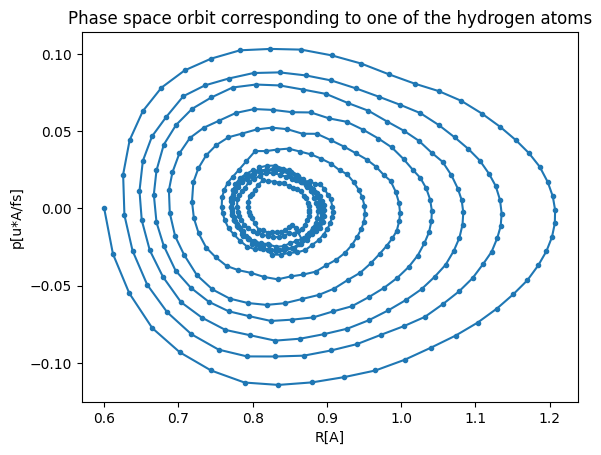

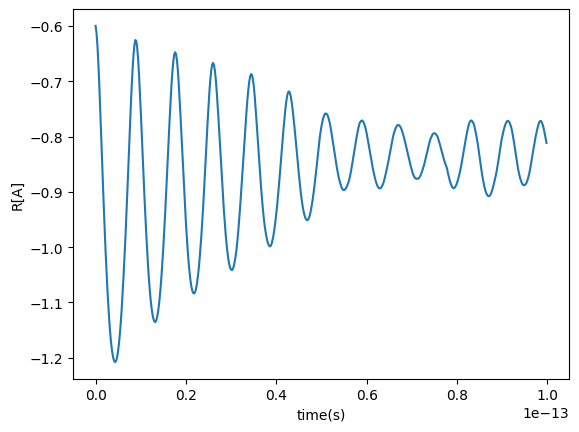

In [28]:
coords_diag_np = np.array(coords_diag)
momentum_diag_np = np.array(momentum_diag)
dist_diag = coords_diag_np[:,1]-coords_diag_np[:,0]
p_diag = momentum_diag_np[:,0]

plt.plot(dist_diag, p_diag, marker='.')
plt.title('Phase space orbit corresponding to one of the hydrogen atoms')
plt.xlabel("R[A]")
plt.ylabel("p[u*A/fs]")
plt.show()

rel_dist_diag = coords_diag_np[:-1,0] - coords_diag_np[:-1,1]
plt.plot(times, rel_dist_diag)
plt.xlabel("time(s)")
plt.ylabel("R[A]")
plt.show()

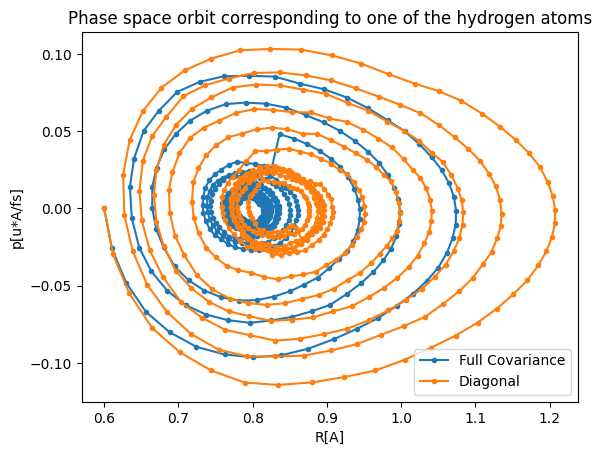

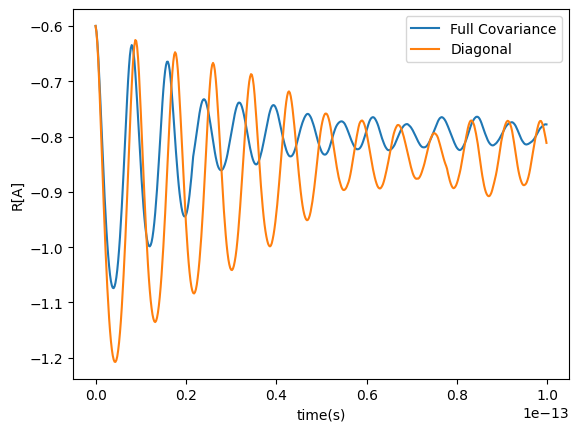

In [29]:
plt.plot(dist, p, marker='.', label="Full Covariance")
plt.plot(dist_diag, p_diag, marker='.', label="Diagonal")
plt.title('Phase space orbit corresponding to one of the hydrogen atoms')
plt.xlabel("R[A]")
plt.ylabel("p[u*A/fs]")
plt.legend()
plt.show()

plt.plot(times, rel_dist, label="Full Covariance")
plt.plot(times, rel_dist_diag, label="Diagonal")
plt.xlabel("time(s)")
plt.ylabel("R[A]")
plt.legend()
plt.show()